# Imports

In [1]:
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score,f1_score, roc_auc_score,confusion_matrix, ConfusionMatrixDisplay

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer


import sys
sys.path.append('/kaggle/usr/lib/airline_customer_satisfaction_common/')  
import airline_customer_satisfaction_common
from airline_customer_satisfaction_common import CustomRename, CustomImputer, CustomFeatureCreator, CustomEncoder, CustomScaler

from sklearn.ensemble import RandomForestClassifier
#from sklearn import tree
from sklearn.tree import plot_tree
import pylab

import math
import datetime

In [2]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)

input_file_path='/kaggle/input/airline-csv/'

import warnings
warnings.filterwarnings('ignore')

import logging
import os
output_dir = "/kaggle/working/"
log_file_path = os.path.join(output_dir, 'airline_satisfaction_random_forest.log')
os.makedirs(output_dir, exist_ok=True)

logging.basicConfig(filename=log_file_path,
                    filemode='a',
                    format='%(asctime)s,%(msecs)03d %(name)s %(levelname)s %(message)s',
                    datefmt='%Y-%m-%d %H:%M:%S',
                    level=logging.DEBUG,
                    force=False)

# Creating an object
logger = logging.getLogger()

# Setting the threshold of logger to DEBUG
logger.setLevel(logging.DEBUG)

In [3]:
#load dataset
df_original = pd.read_csv(input_file_path+"Invistico_Airline.csv")

In [4]:
df_original.info()
df_original.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 22 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   satisfaction                       129880 non-null  object 
 1   Customer Type                      129880 non-null  object 
 2   Age                                129880 non-null  int64  
 3   Type of Travel                     129880 non-null  object 
 4   Class                              129880 non-null  object 
 5   Flight Distance                    129880 non-null  int64  
 6   Seat comfort                       129880 non-null  int64  
 7   Departure/Arrival time convenient  129880 non-null  int64  
 8   Food and drink                     129880 non-null  int64  
 9   Gate location                      129880 non-null  int64  
 10  Inflight wifi service              129880 non-null  int64  
 11  Inflight entertainment             1298

,satisfaction,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
0,satisfied,Loyal Customer,65,Personal Travel,Eco,265,0,0,0,2,2,4,2,3,3,0,3,5,3,2,0,0.0
1,satisfied,Loyal Customer,47,Personal Travel,Business,2464,0,0,0,3,0,2,2,3,4,4,4,2,3,2,310,305.0
2,satisfied,Loyal Customer,15,Personal Travel,Eco,2138,0,0,0,3,2,0,2,2,3,3,4,4,4,2,0,0.0
3,satisfied,Loyal Customer,60,Personal Travel,Eco,623,0,0,0,3,3,4,3,1,1,0,1,4,1,3,0,0.0
4,satisfied,Loyal Customer,70,Personal Travel,Eco,354,0,0,0,3,4,3,4,2,2,0,2,4,2,5,0,0.0


# Clean data, transform data

* Plan A: drop rows which have missing values
    * According to EDA, we know that 393 rows have missing values, 0.3% of total, we could delete them
* Plan B: drop cols which have missing values
    * According to EDA, we know that departure_delay_in_minutes and arrival_delay_in_minutes are correlated, we could use one of them


Reference:
* [How To Write Clean And Scalable Code With Custom Transformers & Sklearn Pipelines](https://medium.com/@benlc77/how-to-write-clean-and-scalable-code-with-custom-transformers-sklearn-pipelines-ecb8e53fe110)
* [Missing value imputation using Sklearn pipelines](https://marloz.github.io/projects/sklearn/pipeline/missing/preprocessing/2020/03/20/sklearn-pipelines-missing-values.html)
* [SimpleImputer](https://scikit-learn.org/stable/modules/generated/sklearn.impute.SimpleImputer.html)
* [OneHotEncoder](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.OneHotEncoder.html)

In [5]:
############################################################
# Clean data, transform data
# Plan A
############################################################
data_process_pipeline = Pipeline(
    steps=[
        ('rename_features',CustomRename()),
        ("impute_features", CustomImputer(missing_values = np.nan, 
                        strategy ='drop_row')),   
        ('create_new_features',CustomFeatureCreator()),   
    ]
)
data_process_pipeline=data_process_pipeline.fit(df_original)
df_trans_drop_row=data_process_pipeline.transform(df_original)
print(df_trans_drop_row.shape)
df_trans_drop_row.head(10)

(129487, 45)


,satisfaction,customer_type,age,type_of_travel,class,flight_distance,seat_comfort,departure_arrival_time_convenient,food_and_drink,gate_location,inflight_wifi_service,inflight_entertainment,online_support,ease_of_online_booking,on_board_service,leg_room_service,baggage_handling,checkin_service,cleanliness,online_boarding,departure_delay_in_minutes,arrival_delay_in_minutes,departure_delay_in_hours,departure_delay_class,arrival_delay_in_hours,arrival_delay_class,flight_distance_range,flight_distance_class,age_range,age_class_by_airline,seat_comfort_class,departure_arrival_time_convenient_class,food_and_drink_class,gate_location_class,inflight_wifi_service_class,inflight_entertainment_class,online_support_class,ease_of_online_booking_class,on_board_service_class,leg_room_service_class,baggage_handling_class,checkin_service_class,cleanliness_class,online_boarding_class,class_m
0,satisfied,Loyal Customer,65,Personal Travel,Eco,265,0,0,0,2,2,4,2,3,3,0,3,5,3,2,0,0.0,0.0,No Delay,0.0,No Delay,<1K,Short-Haul,"[60,70)",Senior,Low,Low,Low,Median,Median,High,Median,Median,Median,Low,Median,High,Median,Median,Eco&EcoPlus
1,satisfied,Loyal Customer,47,Personal Travel,Business,2464,0,0,0,3,0,2,2,3,4,4,4,2,3,2,310,305.0,5.0,Significant Delay,5.0,Significant Delay,"[1K,3K)",Medium-Haul,"[40,50)",Adult,Low,Low,Low,Median,Low,Median,Median,Median,High,High,High,Median,Median,Median,Business
2,satisfied,Loyal Customer,15,Personal Travel,Eco,2138,0,0,0,3,2,0,2,2,3,3,4,4,4,2,0,0.0,0.0,No Delay,0.0,No Delay,"[1K,3K)",Medium-Haul,"[10,20)",Young-Adult,Low,Low,Low,Median,Median,Low,Median,Median,Median,Median,High,High,High,Median,Eco&EcoPlus
3,satisfied,Loyal Customer,60,Personal Travel,Eco,623,0,0,0,3,3,4,3,1,1,0,1,4,1,3,0,0.0,0.0,No Delay,0.0,No Delay,<1K,Short-Haul,"[60,70)",Adult,Low,Low,Low,Median,Median,High,Median,Low,Low,Low,Low,High,Low,Median,Eco&EcoPlus
4,satisfied,Loyal Customer,70,Personal Travel,Eco,354,0,0,0,3,4,3,4,2,2,0,2,4,2,5,0,0.0,0.0,No Delay,0.0,No Delay,<1K,Short-Haul,>=70,Senior,Low,Low,Low,Median,High,Median,High,Median,Median,Low,Median,High,Median,High,Eco&EcoPlus
5,satisfied,Loyal Customer,30,Personal Travel,Eco,1894,0,0,0,3,2,0,2,2,5,4,5,5,4,2,0,0.0,0.0,No Delay,0.0,No Delay,"[1K,3K)",Medium-Haul,"[30,40)",Adult,Low,Low,Low,Median,Median,Low,Median,Median,High,High,High,High,High,Median,Eco&EcoPlus
6,satisfied,Loyal Customer,66,Personal Travel,Eco,227,0,0,0,3,2,5,5,5,5,0,5,5,5,3,17,15.0,0.0,Minor Delay,0.0,Minor Delay,<1K,Short-Haul,"[60,70)",Senior,Low,Low,Low,Median,Median,High,High,High,High,Low,High,High,High,Median,Eco&EcoPlus
7,satisfied,Loyal Customer,10,Personal Travel,Eco,1812,0,0,0,3,2,0,2,2,3,3,4,5,4,2,0,0.0,0.0,No Delay,0.0,No Delay,"[1K,3K)",Medium-Haul,"[10,20)",Children,Low,Low,Low,Median,Median,Low,Median,Median,Median,Median,High,High,High,Median,Eco&EcoPlus
8,satisfied,Loyal Customer,56,Personal Travel,Business,73,0,0,0,3,5,3,5,4,4,0,1,5,4,4,0,0.0,0.0,No Delay,0.0,No Delay,<1K,Short-Haul,"[50,60)",Adult,Low,Low,Low,Median,High,Median,High,High,High,Low,Low,High,High,High,Business
9,satisfied,Loyal Customer,22,Personal Travel,Eco,1556,0,0,0,3,2,0,2,2,2,4,5,3,4,2,30,26.0,0.0,Minor Delay,0.0,Minor Delay,"[1K,3K)",Medium-Haul,"[20,30)",Adult,Low,Low,Low,Median,Median,Low,Median,Median,Median,High,High,Median,High,Median,Eco&EcoPlus


In [6]:
############################################################
# Clean data, transform data
# Plan B
############################################################
data_process_pipeline = Pipeline(
    steps=[
        ('rename_features',CustomRename()),
        ("impute_features", CustomImputer(missing_values = np.nan, 
                        strategy ='drop_col')),   
        ('create_new_features',CustomFeatureCreator()),   
    ]
)
data_process_pipeline=data_process_pipeline.fit(df_original)
df_trans_drop_col=data_process_pipeline.transform(df_original)
print(df_trans_drop_col.shape)
df_trans_drop_col.head(10)

(129880, 42)


,satisfaction,customer_type,age,type_of_travel,class,flight_distance,seat_comfort,departure_arrival_time_convenient,food_and_drink,gate_location,inflight_wifi_service,inflight_entertainment,online_support,ease_of_online_booking,on_board_service,leg_room_service,baggage_handling,checkin_service,cleanliness,online_boarding,departure_delay_in_minutes,departure_delay_in_hours,departure_delay_class,flight_distance_range,flight_distance_class,age_range,age_class_by_airline,seat_comfort_class,departure_arrival_time_convenient_class,food_and_drink_class,gate_location_class,inflight_wifi_service_class,inflight_entertainment_class,online_support_class,ease_of_online_booking_class,on_board_service_class,leg_room_service_class,baggage_handling_class,checkin_service_class,cleanliness_class,online_boarding_class,class_m
0,satisfied,Loyal Customer,65,Personal Travel,Eco,265,0,0,0,2,2,4,2,3,3,0,3,5,3,2,0,0.0,No Delay,<1K,Short-Haul,"[60,70)",Senior,Low,Low,Low,Median,Median,High,Median,Median,Median,Low,Median,High,Median,Median,Eco&EcoPlus
1,satisfied,Loyal Customer,47,Personal Travel,Business,2464,0,0,0,3,0,2,2,3,4,4,4,2,3,2,310,5.0,Significant Delay,"[1K,3K)",Medium-Haul,"[40,50)",Adult,Low,Low,Low,Median,Low,Median,Median,Median,High,High,High,Median,Median,Median,Business
2,satisfied,Loyal Customer,15,Personal Travel,Eco,2138,0,0,0,3,2,0,2,2,3,3,4,4,4,2,0,0.0,No Delay,"[1K,3K)",Medium-Haul,"[10,20)",Young-Adult,Low,Low,Low,Median,Median,Low,Median,Median,Median,Median,High,High,High,Median,Eco&EcoPlus
3,satisfied,Loyal Customer,60,Personal Travel,Eco,623,0,0,0,3,3,4,3,1,1,0,1,4,1,3,0,0.0,No Delay,<1K,Short-Haul,"[60,70)",Adult,Low,Low,Low,Median,Median,High,Median,Low,Low,Low,Low,High,Low,Median,Eco&EcoPlus
4,satisfied,Loyal Customer,70,Personal Travel,Eco,354,0,0,0,3,4,3,4,2,2,0,2,4,2,5,0,0.0,No Delay,<1K,Short-Haul,>=70,Senior,Low,Low,Low,Median,High,Median,High,Median,Median,Low,Median,High,Median,High,Eco&EcoPlus
5,satisfied,Loyal Customer,30,Personal Travel,Eco,1894,0,0,0,3,2,0,2,2,5,4,5,5,4,2,0,0.0,No Delay,"[1K,3K)",Medium-Haul,"[30,40)",Adult,Low,Low,Low,Median,Median,Low,Median,Median,High,High,High,High,High,Median,Eco&EcoPlus
6,satisfied,Loyal Customer,66,Personal Travel,Eco,227,0,0,0,3,2,5,5,5,5,0,5,5,5,3,17,0.0,Minor Delay,<1K,Short-Haul,"[60,70)",Senior,Low,Low,Low,Median,Median,High,High,High,High,Low,High,High,High,Median,Eco&EcoPlus
7,satisfied,Loyal Customer,10,Personal Travel,Eco,1812,0,0,0,3,2,0,2,2,3,3,4,5,4,2,0,0.0,No Delay,"[1K,3K)",Medium-Haul,"[10,20)",Children,Low,Low,Low,Median,Median,Low,Median,Median,Median,Median,High,High,High,Median,Eco&EcoPlus
8,satisfied,Loyal Customer,56,Personal Travel,Business,73,0,0,0,3,5,3,5,4,4,0,1,5,4,4,0,0.0,No Delay,<1K,Short-Haul,"[50,60)",Adult,Low,Low,Low,Median,High,Median,High,High,High,Low,Low,High,High,High,Business
9,satisfied,Loyal Customer,22,Personal Travel,Eco,1556,0,0,0,3,2,0,2,2,2,4,5,3,4,2,30,0.0,Minor Delay,"[1K,3K)",Medium-Haul,"[20,30)",Adult,Low,Low,Low,Median,Median,Low,Median,Median,Median,High,High,Median,High,Median,Eco&EcoPlus


### Encode data

* Plan A:
    * Dummy encoding `customer_type` and `type_of_travel`
    * Ordinal encoding `class`,`class_m`,`age_range`,`age_class_by_airline`,`flight_distance_range`,`flight_distance_class`,
`departure_delay_class`,`satisfaction`,
`seat_comfort_class`, `departure_arrival_time_convenient_class`, `food_and_drink_class`,
`gate_location_class`, `inflight_wifi_service_class`,
`inflight_entertainment_class`, `online_support_class`,
`ease_of_online_booking_class`, `on_board_service_class`,
`leg_room_service_class`, `baggage_handling_class`,
`checkin_service_class`, `cleanliness_class`, `online_boarding_class`
* Plan B: drop cols which have missing values
    * Dummy encoding `class`,`class_m`,`age_range`,`age_class_by_airline`,`flight_distance_range`,`flight_distance_class`,`departure_delay_class`, `customer_type`,`type_of_travel`,
`seat_comfort_class`, `departure_arrival_time_convenient_class`, `food_and_drink_class`,
`gate_location_class`, `inflight_wifi_service_class`,
`inflight_entertainment_class`, `online_support_class`,
`ease_of_online_booking_class`, `on_board_service_class`,
`leg_room_service_class`, `baggage_handling_class`,
`checkin_service_class`, `cleanliness_class`, `online_boarding_class`,
`seat_comfort`, `departure_arrival_time_convenient`,
`food_and_drink`, `gate_location`, `inflight_wifi_service`,
`inflight_entertainment`, `online_support`, `ease_of_online_booking`,
`on_board_service`, `leg_room_service`, `baggage_handling`,
`checkin_service`, `cleanliness`, `online_boarding`
    * Ordinal encoding `satisfaction`

In [7]:
############################################################
# Encode data
# Plan A: df_trans_drop_row
# Encode data: Plan A
############################################################
ordinal_list=['class','class_m','age_range','age_class_by_airline','flight_distance_range','flight_distance_class',
              'departure_delay_class','satisfaction',
               'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
               'gate_location_class', 'inflight_wifi_service_class',
               'inflight_entertainment_class', 'online_support_class',
               'ease_of_online_booking_class', 'on_board_service_class',
               'leg_room_service_class', 'baggage_handling_class',
               'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
onehot_list=['customer_type','type_of_travel']

data_encode_pipeline = Pipeline(
    steps=[
        ('encode_features',CustomEncoder(ordinal_col_list=ordinal_list,dummy_col_list=onehot_list)), 
    ]
)

data_encode_pipeline=data_encode_pipeline.fit(df_trans_drop_row)
df_encode_aa=data_encode_pipeline.transform(df_trans_drop_row)
print(df_encode_aa.shape)
df_encode_aa.head(10)

(129487, 45)


,satisfaction,age,class,flight_distance,seat_comfort,departure_arrival_time_convenient,food_and_drink,gate_location,inflight_wifi_service,inflight_entertainment,online_support,ease_of_online_booking,on_board_service,leg_room_service,baggage_handling,checkin_service,cleanliness,online_boarding,departure_delay_in_minutes,arrival_delay_in_minutes,departure_delay_in_hours,departure_delay_class,arrival_delay_in_hours,arrival_delay_class,flight_distance_range,flight_distance_class,age_range,age_class_by_airline,seat_comfort_class,departure_arrival_time_convenient_class,food_and_drink_class,gate_location_class,inflight_wifi_service_class,inflight_entertainment_class,online_support_class,ease_of_online_booking_class,on_board_service_class,leg_room_service_class,baggage_handling_class,checkin_service_class,cleanliness_class,online_boarding_class,class_m,customer_type_dummy_disloyal_customer,type_of_travel_dummy_personal_travel
0,1,65,0,265,0,0,0,2,2,4,2,3,3,0,3,5,3,2,0,0.0,0.0,0,0.0,No Delay,0,0,6,4,0,0,0,1,1,2,1,1,1,0,1,2,1,1,0,0,1
1,1,47,2,2464,0,0,0,3,0,2,2,3,4,4,4,2,3,2,310,305.0,5.0,3,5.0,Significant Delay,1,1,4,3,0,0,0,1,0,1,1,1,2,2,2,1,1,1,1,0,1
2,1,15,0,2138,0,0,0,3,2,0,2,2,3,3,4,4,4,2,0,0.0,0.0,0,0.0,No Delay,1,1,1,2,0,0,0,1,1,0,1,1,1,1,2,2,2,1,0,0,1
3,1,60,0,623,0,0,0,3,3,4,3,1,1,0,1,4,1,3,0,0.0,0.0,0,0.0,No Delay,0,0,6,3,0,0,0,1,1,2,1,0,0,0,0,2,0,1,0,0,1
4,1,70,0,354,0,0,0,3,4,3,4,2,2,0,2,4,2,5,0,0.0,0.0,0,0.0,No Delay,0,0,7,4,0,0,0,1,2,1,2,1,1,0,1,2,1,2,0,0,1
5,1,30,0,1894,0,0,0,3,2,0,2,2,5,4,5,5,4,2,0,0.0,0.0,0,0.0,No Delay,1,1,3,3,0,0,0,1,1,0,1,1,2,2,2,2,2,1,0,0,1
6,1,66,0,227,0,0,0,3,2,5,5,5,5,0,5,5,5,3,17,15.0,0.0,1,0.0,Minor Delay,0,0,6,4,0,0,0,1,1,2,2,2,2,0,2,2,2,1,0,0,1
7,1,10,0,1812,0,0,0,3,2,0,2,2,3,3,4,5,4,2,0,0.0,0.0,0,0.0,No Delay,1,1,1,1,0,0,0,1,1,0,1,1,1,1,2,2,2,1,0,0,1
8,1,56,2,73,0,0,0,3,5,3,5,4,4,0,1,5,4,4,0,0.0,0.0,0,0.0,No Delay,0,0,5,3,0,0,0,1,2,1,2,2,2,0,0,2,2,2,1,0,1
9,1,22,0,1556,0,0,0,3,2,0,2,2,2,4,5,3,4,2,30,26.0,0.0,1,0.0,Minor Delay,1,1,2,3,0,0,0,1,1,0,1,1,1,2,2,1,2,1,0,0,1


In [8]:
############################################################
# Encode data
# Plan A: df_trans_drop_row
# Encode data: Plan B
############################################################

ordinal_list=['satisfaction']

onehot_list=['class','class_m','age_range','age_class_by_airline','flight_distance_range','flight_distance_class','departure_delay_class', 'customer_type','type_of_travel',
               'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
               'gate_location_class', 'inflight_wifi_service_class',
               'inflight_entertainment_class', 'online_support_class',
               'ease_of_online_booking_class', 'on_board_service_class',
               'leg_room_service_class', 'baggage_handling_class',
               'checkin_service_class', 'cleanliness_class', 'online_boarding_class',
               'seat_comfort', 'departure_arrival_time_convenient',
               'food_and_drink', 'gate_location', 'inflight_wifi_service',
               'inflight_entertainment', 'online_support', 'ease_of_online_booking',
               'on_board_service', 'leg_room_service', 'baggage_handling',
               'checkin_service', 'cleanliness', 'online_boarding']

data_encode_pipeline = Pipeline(
    steps=[
        ('encode_features',CustomEncoder(ordinal_col_list=ordinal_list,dummy_col_list=onehot_list)), 
    ]
)
data_encode_pipeline=data_encode_pipeline.fit(df_trans_drop_row)
df_encode_ab=data_encode_pipeline.transform(df_trans_drop_row)
print(df_encode_ab.shape)
df_encode_ab.head(10)

(129487, 128)


,satisfaction,age,flight_distance,departure_delay_in_minutes,arrival_delay_in_minutes,departure_delay_in_hours,arrival_delay_in_hours,arrival_delay_class,customer_type_dummy_disloyal_customer,type_of_travel_dummy_personal_travel,class_dummy_eco,class_dummy_eco_plus,seat_comfort_dummy_1,seat_comfort_dummy_2,seat_comfort_dummy_3,seat_comfort_dummy_4,seat_comfort_dummy_5,departure_arrival_time_convenient_dummy_1,departure_arrival_time_convenient_dummy_2,departure_arrival_time_convenient_dummy_3,departure_arrival_time_convenient_dummy_4,departure_arrival_time_convenient_dummy_5,food_and_drink_dummy_1,food_and_drink_dummy_2,food_and_drink_dummy_3,food_and_drink_dummy_4,food_and_drink_dummy_5,gate_location_dummy_1,gate_location_dummy_2,gate_location_dummy_3,gate_location_dummy_4,gate_location_dummy_5,inflight_wifi_service_dummy_1,inflight_wifi_service_dummy_2,inflight_wifi_service_dummy_3,inflight_wifi_service_dummy_4,inflight_wifi_service_dummy_5,inflight_entertainment_dummy_1,inflight_entertainment_dummy_2,inflight_entertainment_dummy_3,inflight_entertainment_dummy_4,inflight_entertainment_dummy_5,online_support_dummy_1,online_support_dummy_2,online_support_dummy_3,online_support_dummy_4,online_support_dummy_5,ease_of_online_booking_dummy_1,ease_of_online_booking_dummy_2,ease_of_online_booking_dummy_3,ease_of_online_booking_dummy_4,ease_of_online_booking_dummy_5,on_board_service_dummy_1,on_board_service_dummy_2,on_board_service_dummy_3,on_board_service_dummy_4,on_board_service_dummy_5,leg_room_service_dummy_1,leg_room_service_dummy_2,leg_room_service_dummy_3,leg_room_service_dummy_4,leg_room_service_dummy_5,baggage_handling_dummy_2,baggage_handling_dummy_3,baggage_handling_dummy_4,baggage_handling_dummy_5,checkin_service_dummy_1,checkin_service_dummy_2,checkin_service_dummy_3,checkin_service_dummy_4,checkin_service_dummy_5,cleanliness_dummy_1,cleanliness_dummy_2,cleanliness_dummy_3,cleanliness_dummy_4,cleanliness_dummy_5,online_boarding_dummy_1,online_boarding_dummy_2,online_boarding_dummy_3,online_boarding_dummy_4,online_boarding_dummy_5,departure_delay_class_dummy_moderate_delay,departure_delay_class_dummy_no_delay,departure_delay_class_dummy_significant_delay,flight_distance_range_dummy_gte4k,flight_distance_range_dummy_1k_3k,flight_distance_range_dummy_3k_4k,flight_distance_class_dummy_medium_haul,flight_distance_class_dummy_short_haul,age_range_dummy_gte70,age_range_dummy_10_20,age_range_dummy_20_30,age_range_dummy_30_40,age_range_dummy_40_50,age_range_dummy_50_60,age_range_dummy_60_70,age_class_by_airline_dummy_children,age_class_by_airline_dummy_senior,age_class_by_airline_dummy_young_adult,seat_comfort_class_dummy_low,seat_comfort_class_dummy_median,departure_arrival_time_convenient_class_dummy_low,departure_arrival_time_convenient_class_dummy_median,food_and_drink_class_dummy_low,food_and_drink_class_dummy_median,gate_location_class_dummy_low,gate_location_class_dummy_median,inflight_wifi_service_class_dummy_low,inflight_wifi_service_class_dummy_median,inflight_entertainment_class_dummy_low,inflight_entertainment_class_dummy_median,online_support_class_dummy_low,online_support_class_dummy_median,ease_of_online_booking_class_dummy_low,ease_of_online_booking_class_dummy_median,on_board_service_class_dummy_low,on_board_service_class_dummy_median,leg_room_service_class_dummy_low,leg_room_service_class_dummy_median,baggage_handling_class_dummy_low,baggage_handling_class_dummy_median,checkin_service_class_dummy_low,checkin_service_class_dummy_median,cleanliness_class_dummy_low,cleanliness_class_dummy_median,online_boarding_class_dummy_low,online_boarding_class_dummy_median,class_m_dummy_eco_ecoplus
0,1,65,265,0,0.0,0.0,0.0,No Delay,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,1,0,1,0,1,0,0,1,0,1,0,0,0,1,0,1,0,1,1,0,0,1,0,0,0,1,0,1,1
1,1,47,2464,310,305.0,5.0,5.0,Significant Delay,0,1,0,0,0,0,0

In [9]:
############################################################
# Encode data
# Plan B: df_trans_drop_col
# Encode data: Plan A
############################################################
ordinal_list=['class','class_m','age_range','age_class_by_airline','flight_distance_range','flight_distance_class',
              'departure_delay_class','satisfaction',
               'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
               'gate_location_class', 'inflight_wifi_service_class',
               'inflight_entertainment_class', 'online_support_class',
               'ease_of_online_booking_class', 'on_board_service_class',
               'leg_room_service_class', 'baggage_handling_class',
               'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
onehot_list=['customer_type','type_of_travel']

data_encode_pipeline = Pipeline(
    steps=[
        ('encode_features',CustomEncoder(ordinal_col_list=ordinal_list,dummy_col_list=onehot_list)), 
    ]
)
data_encode_pipeline=data_encode_pipeline.fit(df_trans_drop_col)
df_encode_ba=data_encode_pipeline.transform(df_trans_drop_col)
print(df_encode_ba.shape)
df_encode_ba.head(10)

(129880, 42)


,satisfaction,age,class,flight_distance,seat_comfort,departure_arrival_time_convenient,food_and_drink,gate_location,inflight_wifi_service,inflight_entertainment,online_support,ease_of_online_booking,on_board_service,leg_room_service,baggage_handling,checkin_service,cleanliness,online_boarding,departure_delay_in_minutes,departure_delay_in_hours,departure_delay_class,flight_distance_range,flight_distance_class,age_range,age_class_by_airline,seat_comfort_class,departure_arrival_time_convenient_class,food_and_drink_class,gate_location_class,inflight_wifi_service_class,inflight_entertainment_class,online_support_class,ease_of_online_booking_class,on_board_service_class,leg_room_service_class,baggage_handling_class,checkin_service_class,cleanliness_class,online_boarding_class,class_m,customer_type_dummy_disloyal_customer,type_of_travel_dummy_personal_travel
0,1,65,0,265,0,0,0,2,2,4,2,3,3,0,3,5,3,2,0,0.0,0,0,0,6,4,0,0,0,1,1,2,1,1,1,0,1,2,1,1,0,0,1
1,1,47,2,2464,0,0,0,3,0,2,2,3,4,4,4,2,3,2,310,5.0,3,1,1,4,3,0,0,0,1,0,1,1,1,2,2,2,1,1,1,1,0,1
2,1,15,0,2138,0,0,0,3,2,0,2,2,3,3,4,4,4,2,0,0.0,0,1,1,1,2,0,0,0,1,1,0,1,1,1,1,2,2,2,1,0,0,1
3,1,60,0,623,0,0,0,3,3,4,3,1,1,0,1,4,1,3,0,0.0,0,0,0,6,3,0,0,0,1,1,2,1,0,0,0,0,2,0,1,0,0,1
4,1,70,0,354,0,0,0,3,4,3,4,2,2,0,2,4,2,5,0,0.0,0,0,0,7,4,0,0,0,1,2,1,2,1,1,0,1,2,1,2,0,0,1
5,1,30,0,1894,0,0,0,3,2,0,2,2,5,4,5,5,4,2,0,0.0,0,1,1,3,3,0,0,0,1,1,0,1,1,2,2,2,2,2,1,0,0,1
6,1,66,0,227,0,0,0,3,2,5,5,5,5,0,5,5,5,3,17,0.0,1,0,0,6,4,0,0,0,1,1,2,2,2,2,0,2,2,2,1,0,0,1
7,1,10,0,1812,0,0,0,3,2,0,2,2,3,3,4,5,4,2,0,0.0,0,1,1,1,1,0,0,0,1,1,0,1,1,1,1,2,2,2,1,0,0,1
8,1,56,2,73,0,0,0,3,5,3,5,4,4,0,1,5,4,4,0,0.0,0,0,0,5,3,0,0,0,1,2,1,2,2,2,0,0,2,2,2,1,0,1
9,1,22,0,1556,0,0,0,3,2,0,2,2,2,4,5,3,4,2,30,0.0,1,1,1,2,3,0,0,0,1,1,0,1,1,1,2,2,1,2,1,0,0,1


In [10]:
############################################################
# Encode data
# Plan B: df_trans_drop_col
# Encode data: Plan B
############################################################
ordinal_list=['satisfaction']

onehot_list=['class','class_m','age_range','age_class_by_airline','flight_distance_range','flight_distance_class','departure_delay_class', 'customer_type','type_of_travel',
               'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
               'gate_location_class', 'inflight_wifi_service_class',
               'inflight_entertainment_class', 'online_support_class',
               'ease_of_online_booking_class', 'on_board_service_class',
               'leg_room_service_class', 'baggage_handling_class',
               'checkin_service_class', 'cleanliness_class', 'online_boarding_class',
               'seat_comfort', 'departure_arrival_time_convenient',
               'food_and_drink', 'gate_location', 'inflight_wifi_service',
               'inflight_entertainment', 'online_support', 'ease_of_online_booking',
               'on_board_service', 'leg_room_service', 'baggage_handling',
               'checkin_service', 'cleanliness', 'online_boarding']

data_encode_pipeline = Pipeline(
    steps=[
        ('encode_features',CustomEncoder(ordinal_col_list=ordinal_list,dummy_col_list=onehot_list)), 
    ]
)

data_encode_pipeline=data_encode_pipeline.fit(df_trans_drop_col)
df_encode_bb=data_encode_pipeline.transform(df_trans_drop_col)
print(df_encode_bb.shape)
df_encode_bb.head(10)

(129880, 125)


,satisfaction,age,flight_distance,departure_delay_in_minutes,departure_delay_in_hours,customer_type_dummy_disloyal_customer,type_of_travel_dummy_personal_travel,class_dummy_eco,class_dummy_eco_plus,seat_comfort_dummy_1,seat_comfort_dummy_2,seat_comfort_dummy_3,seat_comfort_dummy_4,seat_comfort_dummy_5,departure_arrival_time_convenient_dummy_1,departure_arrival_time_convenient_dummy_2,departure_arrival_time_convenient_dummy_3,departure_arrival_time_convenient_dummy_4,departure_arrival_time_convenient_dummy_5,food_and_drink_dummy_1,food_and_drink_dummy_2,food_and_drink_dummy_3,food_and_drink_dummy_4,food_and_drink_dummy_5,gate_location_dummy_1,gate_location_dummy_2,gate_location_dummy_3,gate_location_dummy_4,gate_location_dummy_5,inflight_wifi_service_dummy_1,inflight_wifi_service_dummy_2,inflight_wifi_service_dummy_3,inflight_wifi_service_dummy_4,inflight_wifi_service_dummy_5,inflight_entertainment_dummy_1,inflight_entertainment_dummy_2,inflight_entertainment_dummy_3,inflight_entertainment_dummy_4,inflight_entertainment_dummy_5,online_support_dummy_1,online_support_dummy_2,online_support_dummy_3,online_support_dummy_4,online_support_dummy_5,ease_of_online_booking_dummy_1,ease_of_online_booking_dummy_2,ease_of_online_booking_dummy_3,ease_of_online_booking_dummy_4,ease_of_online_booking_dummy_5,on_board_service_dummy_1,on_board_service_dummy_2,on_board_service_dummy_3,on_board_service_dummy_4,on_board_service_dummy_5,leg_room_service_dummy_1,leg_room_service_dummy_2,leg_room_service_dummy_3,leg_room_service_dummy_4,leg_room_service_dummy_5,baggage_handling_dummy_2,baggage_handling_dummy_3,baggage_handling_dummy_4,baggage_handling_dummy_5,checkin_service_dummy_1,checkin_service_dummy_2,checkin_service_dummy_3,checkin_service_dummy_4,checkin_service_dummy_5,cleanliness_dummy_1,cleanliness_dummy_2,cleanliness_dummy_3,cleanliness_dummy_4,cleanliness_dummy_5,online_boarding_dummy_1,online_boarding_dummy_2,online_boarding_dummy_3,online_boarding_dummy_4,online_boarding_dummy_5,departure_delay_class_dummy_moderate_delay,departure_delay_class_dummy_no_delay,departure_delay_class_dummy_significant_delay,flight_distance_range_dummy_gte4k,flight_distance_range_dummy_1k_3k,flight_distance_range_dummy_3k_4k,flight_distance_class_dummy_medium_haul,flight_distance_class_dummy_short_haul,age_range_dummy_gte70,age_range_dummy_10_20,age_range_dummy_20_30,age_range_dummy_30_40,age_range_dummy_40_50,age_range_dummy_50_60,age_range_dummy_60_70,age_class_by_airline_dummy_children,age_class_by_airline_dummy_senior,age_class_by_airline_dummy_young_adult,seat_comfort_class_dummy_low,seat_comfort_class_dummy_median,departure_arrival_time_convenient_class_dummy_low,departure_arrival_time_convenient_class_dummy_median,food_and_drink_class_dummy_low,food_and_drink_class_dummy_median,gate_location_class_dummy_low,gate_location_class_dummy_median,inflight_wifi_service_class_dummy_low,inflight_wifi_service_class_dummy_median,inflight_entertainment_class_dummy_low,inflight_entertainment_class_dummy_median,online_support_class_dummy_low,online_support_class_dummy_median,ease_of_online_booking_class_dummy_low,ease_of_online_booking_class_dummy_median,on_board_service_class_dummy_low,on_board_service_class_dummy_median,leg_room_service_class_dummy_low,leg_room_service_class_dummy_median,baggage_handling_class_dummy_low,baggage_handling_class_dummy_median,checkin_service_class_dummy_low,checkin_service_class_dummy_median,cleanliness_class_dummy_low,cleanliness_class_dummy_median,online_boarding_class_dummy_low,online_boarding_class_dummy_median,class_m_dummy_eco_ecoplus
0,1,65,265,0,0.0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,1,0,1,0,1,0,0,1,0,1,0,0,0,1,0,1,0,1,1,0,0,1,0,0,0,1,0,1,1
1,1,47,2464,310,5.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,

# Build Model

## Split data

|No|Clean and Transformation |Encode |Split Data  |X_list|
|:-|:-                       |:-     |:-          |:-    |
|1 |Plan A(df_trans_drop_row)|Plan A(most ordinal encoding) |df_encode_aa|X_list[0]|
|2 |Plan A(df_trans_drop_row)|Plan B(most onehot encoding) |df_encode_ab|X_list[1]|
|3 |Plan B(df_trans_drop_col)|Plan A(most ordinal encoding) |df_encode_ba|X_list[2]|
|4 |Plan B(df_trans_drop_col)|Plan B(most onehot encoding) |df_encode_bb|X_list[3]|

In [11]:
############################################################
# Split data
############################################################
RANDOM_STATE=0
depedent_variables=["satisfaction"]

df_encode_list=[df_encode_aa, df_encode_ab, df_encode_ba, df_encode_bb]
X_list=[]
y_list=[]


for df_encode in df_encode_list:
    X, y = df_encode.drop(columns=["satisfaction"]), df_encode["satisfaction"]
    X_list.append(X)
    y_list.append(y)


X_train_val_list=[]
y_train_val_list=[]
X_test_list=[]
y_test_list=[]
X_train_list=[]
y_train_list=[]
X_val_list=[]
y_val_list=[]

for X,y in zip(X_list,y_list):
    X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, 
                                                        test_size=0.25, stratify=y, 
                                                        random_state=RANDOM_STATE)
    
    # Split train into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, 
                                                      test_size=0.2, stratify=y_train_val, 
                                                      random_state=RANDOM_STATE)

    print(X_train_val.shape,y_train_val.shape,X_train.shape,y_train.shape,X_val.shape,y_val.shape,X_test.shape,y_test.shape)
    X_train_val_list.append(X_train_val)
    y_train_val_list.append(y_train_val)
    X_test_list.append(X_test)
    y_test_list.append(y_test)
    X_train_list.append(X_train)
    y_train_list.append(y_train)
    X_val_list.append(X_val)
    y_val_list.append(y_val)


(97115, 44) (97115,) (77692, 44) (77692,) (19423, 44) (19423,) (32372, 44) (32372,)
(97115, 127) (97115,) (77692, 127) (77692,) (19423, 127) (19423,) (32372, 127) (32372,)
(97410, 41) (97410,) (77928, 41) (77928,) (19482, 41) (19482,) (32470, 41) (32470,)
(97410, 124) (97410,) (77928, 124) (77928,) (19482, 124) (19482,) (32470, 124) (32470,)


| No. | Feature                                    | Use or not | Description |
|-----|--------------------------------------------|------------|-------------|
| 0   | satisfaction                               | Use        | Depedent variable |
| 1   | customer_type                              | $\text{Use}^{*1}$||
| 2   | age                                        | $\text{Use}^{*2}$| No linearty relation between independent variable and satisfaction |
| 3   | type_of_travel                             | $\text{Use}^{*1}$ |             |
| 4   | class                                      | $\text{Use}^{*3}$ |             |
| 5   | flight_distance                            | $\text{Use}^{*2}$| No linearty relation between independent variable and satisfaction |
| 6   | seat_comfort                               | $\text{Use}^{*1}$| No linearty relation between independent variable and satisfaction |
| 7   | departure_arrival_time_convenient          | $\text{Use}^{*1}$ | Linearty relation between independent variable and satisfaction(almost no change) |
| 8   | food_and_drink                             | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 9   | gate_location                              | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 10  | inflight_wifi_service                      | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 11  | inflight_entertainment                     | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 12  | online_support                             | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 13  | ease_of_online_booking                     | $\text{Use}^{*1}$ | Linearty relation between independent variable and satisfaction |
| 14  | on_board_service                           | $\text{Use}^{*1}$ | Linearty relation between independent variable and satisfaction |
| 15  | leg_room_service                           | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 16  | baggage_handling                           | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 17  | checkin_service                            | $\text{Use}^{*1}$ | Linearty relation between independent variable and satisfaction |
| 18  | cleanliness                                | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 19  | online_boarding                            | $\text{Use}^{*1}$ | Linearty relation between independent variable and satisfaction |
| 20  | departure_delay_in_minutes                 | $\text{Use}^{*2}$ | No linearty relation between independent variable and satisfaction |
| 21  | arrival_delay_in_minutes                   | $\text{Use}^{*5}$ | No linearty relation between independent variable and satisfaction |
| 22  | departure_delay_in_hours                   | $\text{Use}^{*5}$ | No linearty relation between independent variable and satisfaction |
| 23  | departure_delay_class                      | $\text{Use}^{*4}$ | Linearty relation between independent variable and satisfaction |
| 24  | arrival_delay_in_hours                     | $\text{Use}^{*2}$  | No linearty relation between independent variable and satisfaction |
| 25  | arrival_delay_class                        | $\text{Use}^{*4}$ | Linearty relation between independent variable and satisfaction |
| 26  | flight_distance_range                      | $\text{Use}^{*5}$ | No linearty relation between independent variable and satisfaction |
| 27  | flight_distance_class                      | $\text{Use}^{*5}$ | No linearty relation between independent variable and satisfaction |
| 28  | age_range                                  | $\text{Use}^{*5}$ | No linearty relation between independent variable and satisfaction |
| 29  | age_class_by_airline                       | $\text{Use}^{*5}$ | No linearty relation between independent variable and satisfaction |
| 30  | seat_comfort_class                         | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 31  | departure_arrival_time_convenient_class    | $\text{Use}^{*1}$ | Linearty relation between independent variable and satisfaction |
| 32  | food_and_drink_class                       | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 33  | gate_location_class                        | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 34  | inflight_wifi_service_class                | $\text{Use}^{*1}$ | Linearty relation between independent variable and satisfaction |
| 35  | inflight_entertainment_class               | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 36  | online_support_class                       | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 37  | ease_of_online_booking_class               | $\text{Use}^{*1}$ | Linearty relation between independent variable and satisfaction |
| 38  | on_board_service_class                     | $\text{Use}^{*1}$ | Linearty relation between independent variable and satisfaction |
| 39  | leg_room_service_class                     | $\text{Use}^{*1}$ | Linearty relation between independent variable and satisfaction |
| 40  | baggage_handling_class                     | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 41  | checkin_service_class                      | $\text{Use}^{*1}$ | Linearty relation between independent variable and satisfaction |
| 42  | cleanliness_class                          | $\text{Use}^{*1}$ | No linearty relation between independent variable and satisfaction |
| 43  | online_boarding_class                      | $\text{Use}^{*1}$ | Linearty relation between independent variable and satisfaction |
| 44  | class_m                                    | $\text{Use}^{*3}$ |             |

* Based on real life experience, airline could get `age`, `class`(passenger reserved), `flight_distance`, `departure_delay_in_minutes`, `arrival_delay_in_minutes`
* $\text{Use}^{*1}$: Use this feature with condition that we could get it in production environment
* $\text{Use}^{*2}$: Use this feature with condition that the model doesn't have linearty assumption(e.g. Not use in logistic regression model).
* $\text{Use}^{*3}$: Use this feature with condition that `class` represents the actual class
    * e.g. if `class` means booking status, not actual flight class, passengers may upgrade to higher class or downgrade to lower class. In this case airline could easily get `class` data, however the result may not be reliable or robust if class upgrade/downgrade occur a lot.
    * e.g. if `class` means actual flight class, airline could not easily get `class` data unless they have other approach to get `class` data
* $\text{Use}^{*4}$: `departure_delay_in_minutes` and `arrival_delay_in_minutes` are correlated, use one of them
* $\text{Use}^{*5}$: Use this feature with condition that the model doesn't have linearty assumption or dummy encoding this variable


|Model Features Used|Feature Index|
|:-|:-|
|customer_type+age+type_of_travel+class+flight_distance+rating items+departure_delay_in_minutes+arrival_delay_in_minutes|No.1|
|customer_type+age+type_of_travel+class+flight_distance+rating items+departure_delay_in_minutes|No.2<BR/>No.80-No.89|
|age+type_of_travel+class+flight_distance+rating items+departure_delay_in_minutes|No.3<BR/>No.70-No.79|
|customer_type+age+class+flight_distance+rating items+departure_delay_in_minutes|No.4<BR/>No.60-No.69|
|customer_type+age+type_of_travel+class+flight_distance+departure_delay_in_minutes|No.5<BR/>No.50-No.59|
|age+class+flight_distance+rating items+departure_delay_in_minutes|No.6<BR/>No.40-No.49|
|age+type_of_travel+class+flight_distance+departure_delay_in_minutes|No.7<BR/>No.30-No.39|
|customer_type+age+class+flight_distance+departure_delay_in_minutes|No.8<BR/>No.20-No.29|
|age+class+flight_distance+departure_delay_in_minutes|No.9<BR/>No.10-No.19|

**Note**
* Model Features Used: Some models will use transformed features
* rating items: Survey rating items, e.g. seat_comfort, departure_arrival_time_convenient, etc


In [12]:
select_col_list=[
    #model 1(for comparison purpose, all use original columns)
    ['customer_type','age', 'type_of_travel','class', 'flight_distance', 'seat_comfort',
       'departure_arrival_time_convenient', 'food_and_drink', 'gate_location',
       'inflight_wifi_service', 'inflight_entertainment', 'online_support',
       'ease_of_online_booking', 'on_board_service', 'leg_room_service',
       'baggage_handling', 'checkin_service', 'cleanliness', 'online_boarding',
       'departure_delay_in_minutes', 'arrival_delay_in_minutes'],
    #model 2(no transformation, model 1 - arrival_delay_in_minutes)
    ['customer_type','age', 'type_of_travel','class', 'flight_distance', 'seat_comfort',
       'departure_arrival_time_convenient', 'food_and_drink', 'gate_location',
       'inflight_wifi_service', 'inflight_entertainment', 'online_support',
       'ease_of_online_booking', 'on_board_service', 'leg_room_service',
       'baggage_handling', 'checkin_service', 'cleanliness', 'online_boarding',
       'departure_delay_in_minutes'],
    #model 3(no transformation, model 2 - customer_type)
    ['age', 'type_of_travel','class', 'flight_distance', 'seat_comfort',
       'departure_arrival_time_convenient', 'food_and_drink', 'gate_location',
       'inflight_wifi_service', 'inflight_entertainment', 'online_support',
       'ease_of_online_booking', 'on_board_service', 'leg_room_service',
       'baggage_handling', 'checkin_service', 'cleanliness', 'online_boarding',
       'departure_delay_in_minutes'],
    #model 4(no transformation, model 2 - type_of_travel)
    ['customer_type','age', 'class', 'flight_distance', 'seat_comfort',
       'departure_arrival_time_convenient', 'food_and_drink', 'gate_location',
       'inflight_wifi_service', 'inflight_entertainment', 'online_support',
       'ease_of_online_booking', 'on_board_service', 'leg_room_service',
       'baggage_handling', 'checkin_service', 'cleanliness', 'online_boarding',
       'departure_delay_in_minutes'],
    #model 5(no transformation, model 2 - rating)
    ['customer_type','age', 'type_of_travel','class', 'flight_distance', 'departure_delay_in_minutes'],
    #model 6(no transformation, model 2 - customer_type - type_of_travel)
    ['age','class', 'flight_distance', 'seat_comfort',
       'departure_arrival_time_convenient', 'food_and_drink', 'gate_location',
       'inflight_wifi_service', 'inflight_entertainment', 'online_support',
       'ease_of_online_booking', 'on_board_service', 'leg_room_service',
       'baggage_handling', 'checkin_service', 'cleanliness', 'online_boarding',
       'departure_delay_in_minutes'],
    #model 7(no transformation, model 2 - customer_type - rating)
    ['age', 'type_of_travel','class', 'flight_distance', 'departure_delay_in_minutes'],
    #model 8(no transformation, model 2 - type_of_travel - rating)
    ['customer_type','age','class', 'flight_distance', 'departure_delay_in_minutes'],
    #model 9(no transformation, model 2 - customer_type - type_of_travel - rating)
    ['age', 'class', 'flight_distance', 'departure_delay_in_minutes'],
    #model 10
    ['age_range', 'class', 'flight_distance_range', 'departure_delay_class'],
    #model 11
    ['age_class_by_airline', 'class', 'flight_distance_range', 'departure_delay_class'],
    #model 12
    ['age_range', 'class_m', 'flight_distance_range', 'departure_delay_class'],
    #model 13
    ['age_class_by_airline', 'class_m', 'flight_distance_range', 'departure_delay_class'],
    #model 14
    ['age_range', 'class', 'flight_distance_class', 'departure_delay_class'],
    #model 15
    ['age_class_by_airline', 'class', 'flight_distance_class', 'departure_delay_class'],
    #model 16
    ['age_range', 'class_m', 'flight_distance_class', 'departure_delay_class'],
    #model 17
    ['age_class_by_airline', 'class_m', 'flight_distance_class', 'departure_delay_class'],
    #model 18
    ['age', 'class', 'flight_distance', 'departure_delay_class'],
    #model 19
    ['age_range', 'class', 'flight_distance', 'departure_delay_class'],
    #model 20(model 10 + customer_type)
    ['customer_type','age_range', 'class', 'flight_distance_range', 'departure_delay_class'],
    #model 21(model 11 + customer_type)
    ['customer_type','age_class_by_airline', 'class', 'flight_distance_range', 'departure_delay_class'],
    #model 22(model 12 + customer_type)
    ['customer_type','age_range', 'class_m', 'flight_distance_range', 'departure_delay_class'],
    #model 23(model 13 + customer_type)
    ['customer_type','age_class_by_airline', 'class_m', 'flight_distance_range', 'departure_delay_class'],
    #model 24(model 14 + customer_type)
    ['customer_type','age_range', 'class', 'flight_distance_class', 'departure_delay_class'],
    #model 25(model 15 + customer_type)
    ['customer_type','age_class_by_airline', 'class', 'flight_distance_class', 'departure_delay_class'],
    #model 26(model 16 + customer_type)
    ['customer_type','age_range', 'class_m', 'flight_distance_class', 'departure_delay_class'],
    #model 27(model 17 + customer_type)
    ['customer_type','age_class_by_airline', 'class_m', 'flight_distance_class', 'departure_delay_class'],
    #model 28(model 18 + customer_type)
    ['customer_type','age', 'class', 'flight_distance', 'departure_delay_class'],
    #model 29(model 19 + customer_type)
    ['customer_type','age_range', 'class', 'flight_distance', 'departure_delay_class'],
    #model 30(model 10 + type_of_travel)
    ['age_range', 'class', 'flight_distance_range', 'departure_delay_class','type_of_travel'],
    #model 31(model 11 + type_of_travel)
    ['age_class_by_airline', 'class', 'flight_distance_range', 'departure_delay_class','type_of_travel'],
    #model 32(model 12 + type_of_travel)
    ['age_range', 'class_m', 'flight_distance_range', 'departure_delay_class','type_of_travel'],
    #model 33(model 13 + type_of_travel)
    ['age_class_by_airline', 'class_m', 'flight_distance_range', 'departure_delay_class','type_of_travel'],
    #model 34(model 14 + type_of_travel)
    ['age_range', 'class', 'flight_distance_class', 'departure_delay_class','type_of_travel'],
    #model 35(model 15 + type_of_travel)
    ['age_class_by_airline', 'class', 'flight_distance_class', 'departure_delay_class','type_of_travel'],
    #model 36(model 16 + type_of_travel)
    ['age_range', 'class_m', 'flight_distance_class', 'departure_delay_class','type_of_travel'],
    #model 37(model 17 + type_of_travel)
    ['age_class_by_airline', 'class_m', 'flight_distance_class', 'departure_delay_class','type_of_travel'],
    #model 38(model 18 + type_of_travel)
    ['age', 'class', 'flight_distance', 'departure_delay_class','type_of_travel'],
    #model 39(model 19 + type_of_travel)
    ['age_range', 'class', 'flight_distance', 'departure_delay_class','type_of_travel'],
    #model 40(model 10 + rating)
    ['age_range', 'class', 'flight_distance_range', 'departure_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 41(model 11 + rating)
    ['age_class_by_airline', 'class', 'flight_distance_range', 'departure_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 42(model 12 + rating)
    ['age_range', 'class_m', 'flight_distance_range', 'departure_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 43(model 13 + rating)
    ['age_class_by_airline', 'class_m', 'flight_distance_range', 'departure_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 44(model 14 + rating)
    ['age_range', 'class', 'flight_distance_class', 'departure_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 45(model 15 + rating)
    ['age_class_by_airline', 'class', 'flight_distance_class', 'departure_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 46(model 16 + rating)
    ['age_range', 'class_m', 'flight_distance_class', 'departure_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 47(model 17 + rating)
    ['age_class_by_airline', 'class_m', 'flight_distance_class', 'departure_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 48(model 18 + rating)
    ['age', 'class', 'flight_distance', 'departure_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 49(model 19 + rating)
    ['age_range', 'class', 'flight_distance', 'departure_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 50(model 10 + customer_type + type_of_travel)
    ['age_range', 'class', 'flight_distance_range', 'departure_delay_class','customer_type','type_of_travel'],
    #model 51(model 11 + customer_type + type_of_travel)
    ['age_class_by_airline', 'class', 'flight_distance_range', 'departure_delay_class','customer_type','type_of_travel'],
    #model 52(model 12 + customer_type + type_of_travel)
    ['age_range', 'class_m', 'flight_distance_range', 'departure_delay_class','customer_type','type_of_travel'],
    #model 53(model 13 + customer_type + type_of_travel)
    ['age_class_by_airline', 'class_m', 'flight_distance_range', 'departure_delay_class','customer_type','type_of_travel'],
    #model 54(model 14 + customer_type + type_of_travel)
    ['age_range', 'class', 'flight_distance_class', 'departure_delay_class','customer_type','type_of_travel'],
    #model 55(model 15 + customer_type + type_of_travel)
    ['age_class_by_airline', 'class', 'flight_distance_class', 'departure_delay_class','customer_type','type_of_travel'],
    #model 56(model 16 + customer_type + type_of_travel)
    ['age_range', 'class_m', 'flight_distance_class', 'departure_delay_class','customer_type','type_of_travel'],
    #model 57(model 17 + customer_type + type_of_travel)
    ['age_class_by_airline', 'class_m', 'flight_distance_class', 'departure_delay_class','customer_type','type_of_travel'],
    #model 58(model 18 + customer_type + type_of_travel)
    ['age', 'class', 'flight_distance', 'departure_delay_class','customer_type','type_of_travel'],
    #model 59(model 19 + customer_type + type_of_travel)
    ['age_range', 'class', 'flight_distance', 'departure_delay_class','customer_type','type_of_travel'],
    #model 60(model 10 + customer_type + rating)
    ['age_range', 'class', 'flight_distance_range', 'departure_delay_class','customer_type',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 61(model 11 + customer_type + rating)
    ['age_class_by_airline', 'class', 'flight_distance_range', 'departure_delay_class','customer_type',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 62(model 12 + customer_type + rating)
    ['age_range', 'class_m', 'flight_distance_range', 'departure_delay_class','customer_type',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 63(model 13 + customer_type + rating)
    ['age_class_by_airline', 'class_m', 'flight_distance_range', 'departure_delay_class','customer_type',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 64(model 14 + customer_type + rating)
    ['age_range', 'class', 'flight_distance_class', 'departure_delay_class','customer_type',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 65(model 15 + customer_type + rating)
    ['age_class_by_airline', 'class', 'flight_distance_class', 'departure_delay_class','customer_type',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 66(model 16 + customer_type + rating)
    ['age_range', 'class_m', 'flight_distance_class', 'departure_delay_class','customer_type',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 67(model 17 + customer_type + rating)
    ['age_class_by_airline', 'class_m', 'flight_distance_class', 'departure_delay_class','customer_type',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 68(model 18 + customer_type + rating)
    ['age', 'class', 'flight_distance', 'departure_delay_class','customer_type',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 69(model 19 + customer_type + rating)
    ['age_range', 'class', 'flight_distance', 'departure_delay_class','customer_type',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 70(model 10 + type_of_travel + rating)
    ['age_range', 'class', 'flight_distance_range', 'departure_delay_class','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 71(model 11 + type_of_travel + rating)
    ['age_class_by_airline', 'class', 'flight_distance_range', 'departure_delay_class','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 72(model 12 + type_of_travel + rating)
    ['age_range', 'class_m', 'flight_distance_range', 'departure_delay_class','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 73(model 13 + type_of_travel + rating)
    ['age_class_by_airline', 'class_m', 'flight_distance_range', 'departure_delay_class','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 74(model 14 + type_of_travel + rating)
    ['age_range', 'class', 'flight_distance_class', 'departure_delay_class','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 75(model 15 + type_of_travel + rating)
    ['age_class_by_airline', 'class', 'flight_distance_class', 'departure_delay_class','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 76(model 16 + type_of_travel + rating)
    ['age_range', 'class_m', 'flight_distance_class', 'departure_delay_class','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 77(model 17 + type_of_travel + rating)
    ['age_class_by_airline', 'class_m', 'flight_distance_class', 'departure_delay_class','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 78(model 18 + type_of_travel + rating)
    ['age', 'class', 'flight_distance', 'departure_delay_class','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 79(model 19 + type_of_travel + rating)
    ['age_range', 'class', 'flight_distance', 'departure_delay_class','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 80(model 10 +customer_type + type_of_travel + rating)
    ['age_range', 'class', 'flight_distance_range', 'departure_delay_class','customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 81(model 11 +customer_type + type_of_travel + rating)
    ['age_class_by_airline', 'class', 'flight_distance_range', 'departure_delay_class','customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 82(model 12 +customer_type + type_of_travel + rating)
    ['age_range', 'class_m', 'flight_distance_range', 'departure_delay_class','customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 83(model 13 +customer_type + type_of_travel + rating)
    ['age_class_by_airline', 'class_m', 'flight_distance_range', 'departure_delay_class','customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 84(model 14 +customer_type + type_of_travel + rating)
    ['age_range', 'class', 'flight_distance_class', 'departure_delay_class','customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 85(model 15 +customer_type + type_of_travel + rating)
    ['age_class_by_airline', 'class', 'flight_distance_class', 'departure_delay_class','customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 86(model 16 +customer_type + type_of_travel + rating)
    ['age_range', 'class_m', 'flight_distance_class', 'departure_delay_class','customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 87(model 17 +customer_type + type_of_travel + rating)
    ['age_class_by_airline', 'class_m', 'flight_distance_class', 'departure_delay_class','customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 88(model 18 + customer_type + type_of_travel + rating)
    ['age', 'class', 'flight_distance', 'departure_delay_class','customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
    #model 89(model 19 + customer_type + type_of_travel + rating)
    ['age_range', 'class', 'flight_distance', 'departure_delay_class','customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class', 'food_and_drink_class',
       'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class',
       'ease_of_online_booking_class', 'on_board_service_class',
       'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'],
]

In [13]:

def get_fit_features(select_cols, encoded_cols):
    """
    Get fitting feature list
        select_cols(list): original columns(before encoding)
        encoded_cols(list): encoded columns(after encoding)
    """
    if select_cols is None:
        raise Exception("Please input select_cols")
    if encoded_cols is None:
        raise Exception("Please input encoded_cols")
    select_features=select_cols.copy()
    res_feature_list=[]
    dummy_features=[]

    for sel_col in select_cols:
        exist_flg=False
        for encode_col in encoded_cols:
            if (sel_col in encoded_cols) & (sel_col+'_dummy_' in encode_col):
                raise Exception("Dummy encoding columns duplicated with others, please update column names")
            elif sel_col==encode_col:
                res_feature_list.append(encode_col)
                exist_flg=True
            elif encode_col.startswith(sel_col+'_dummy_'):
                res_feature_list.append(encode_col)
                exist_flg=True
        if exist_flg==False:
            raise Exception(f"{sel_col} doesn't exist")
            

    return res_feature_list


def get_test_scores(model_name:str, preds, y_test_data,preds_prob):
    '''
    Generate a table of test scores.

    In:
    model_name (string): Your choice: how the model will be named in the output table
    preds: numpy array of test predictions
    y_test_data: numpy array of y_test data

    Out:
    table: a pandas df of precision, recall, f1, and accuracy scores for your model
    '''
    accuracy = accuracy_score(y_test_data, preds)
    precision = precision_score(y_test_data, preds)
    recall = recall_score(y_test_data, preds)
    f1 = f1_score(y_test_data, preds)
    

    # Compute the ROC AUC score
    #https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_auc_score.html
    roc_auc = roc_auc_score(y_test_data, preds_prob) 

    table = pd.DataFrame({'model': [model_name],
                        'precision': [precision],
                        'recall': [recall],
                        'F1': [f1],
                        'accuracy': [accuracy],
                        'ROC_AUC': [roc_auc],
                        })

    return table

def confusion_matrix_plot_ax(model, x_data, y_data,ax,title='Confusion matrix'):
    '''
    Accepts as argument model object, X data (test or validate), and y data (test or validate). 
    Returns a plot of confusion matrix for predictions on y data.
    ''' 
  
    model_pred = model.predict(x_data)
    cm = confusion_matrix(y_data, model_pred, labels=model.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             display_labels=model.classes_)
  
    disp.plot(values_format='',ax=ax)  # `values_format=''` suppresses scientific notation
    ax.set_title(title)

In [14]:
import pickle 

# Define a path to the folder where you want to save the model
path = '/kaggle/working/'
path_tmp='/kaggle/temp/'

path_rf = path+'rf_pickle/'
path_rf_tmp=path_tmp+'rf_pickle/'
path_image=path+'image/'

import os
def create_dir(dir_path):
    # Create the directory
    try:
        os.mkdir(dir_path)
        print(f"Directory '{dir_path}' created successfully.")
    except FileExistsError:
        print(f"Directory '{dir_path}' already exists.")
    except PermissionError:
        print(f"Permission denied: Unable to create '{dir_path}'.")
    except Exception as e:
        print(f"An error occurred: {e}")

def write_pickle(path, model_object, save_name:str):
    '''
    save_name is a string.
    '''
    with open(path + save_name + '.pickle', 'wb') as to_write:
        pickle.dump(model_object, to_write)

def read_pickle(path, saved_model_name:str):
    '''
    saved_model_name is a string.
    '''
    with open(path + saved_model_name + '.pickle', 'rb') as to_read:
        model = pickle.load(to_read)
        return model

import re
def find_number(text, c):
    temp = re.findall(r'%s(\d+)' % c, text)
    res = list(map(int, temp))
    return res

import os.path
def check_picklefile_exists(path, saved_model_name:str):
    """
    Check if pickle exists
    """
    fname=path + saved_model_name + '.pickle'
    if os.path.isfile(fname)==True:
        return True
    else:
        return False


def compute_run_duration(run_start_time,run_end_time):
    run_duration=run_end_time-run_start_time
    run_minutes=math.floor(run_duration.total_seconds()/60)
    run_seconds=math.floor(run_duration.total_seconds()-run_minutes*60)
    return f'{run_minutes} min {run_seconds} s'

def compute_index_list(input_index):
    """
        compute index list
        Input:
           input_index(int or list): input index
        Output:
            output_index_list(list): list of int
                return [1,input_index] when input_index is int
                return input_index when input_index is a list
    """
    if type(input_index)==int:
        if input_index<1:
            raise Exception("Index start from 1")
        else:
            output_index_list=list(range(1,input_index+1))
    elif type(input_index)==list:
        output_index_list=input_index.copy()
        for index_num in output_index_list:
            if type(index_num) != int:
                raise Exception("Index should be int") 
    else:
        raise Exception("Index should be int or list")
    return output_index_list

def chk_encoding_type(encoding_type):
    valid_encoding=['mix']
    if type(encoding_type) == str:
        if encoding_type not in valid_encoding:
            raise Exception("Only 'mix' allowed")
    elif type(encoding_type) == list:
        if (set(valid_encoding)==set(encoding_type)) &(len(valid_encoding)==len(encoding_type)) == False:
            raise Exception("Only 'mix' allowed")

def compute_encoding_list(encoding_type):  
    chk_encoding_type(encoding_type)
    if type(encoding_type)==str:
        encoding_type_list=[encoding_type]
    elif type(encoding_type)==list:
        encoding_type_list=encoding_type
    return encoding_type_list


### [Random Forest](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html)

In [15]:
###################################################
#Create Directory for pickle file
###################################################
#store fir model without tuning
create_dir(path_tmp)
create_dir(path_rf_tmp)
#store tuned models
create_dir(path_rf)


Directory '/kaggle/temp/' created successfully.
Directory '/kaggle/temp/rf_pickle/' created successfully.
Directory '/kaggle/working/rf_pickle/' created successfully.


In [16]:
###################################################
#Copy pickles files to pickle folders
#Output folder will clear after session stop
#need to copy previous results
###################################################

import os
import glob
import shutil
 
source = '/kaggle/input/airline-csv/pickle/pickle/rf_pickle/'
destination = path_rf

# gather all files
allfiles = glob.glob(os.path.join(source, 'rf_*.pickle'), recursive=True)
#print("Files to copy", allfiles)
 
# iterate on all files to move them to destination folder
for file_path in allfiles:
    dst_path = os.path.join(destination, os.path.basename(file_path))
    shutil.copyfile(file_path, dst_path)
    print(f"Copied {file_path} -> {dst_path}")

Copied /kaggle/input/airline-csv/pickle/pickle/rf_pickle/rf_mix1_df3_cv80_hyp1_gs1.pickle -> /kaggle/working/rf_pickle/rf_mix1_df3_cv80_hyp1_gs1.pickle
Copied /kaggle/input/airline-csv/pickle/pickle/rf_pickle/rf_mix1_df3_cv39_hyp1_gs1.pickle -> /kaggle/working/rf_pickle/rf_mix1_df3_cv39_hyp1_gs1.pickle
Copied /kaggle/input/airline-csv/pickle/pickle/rf_pickle/rf_mix1_df3_cv52_hyp1_gs1.pickle -> /kaggle/working/rf_pickle/rf_mix1_df3_cv52_hyp1_gs1.pickle
Copied /kaggle/input/airline-csv/pickle/pickle/rf_pickle/rf_mix1_df3_cv22_hyp1_gs1.pickle -> /kaggle/working/rf_pickle/rf_mix1_df3_cv22_hyp1_gs1.pickle
Copied /kaggle/input/airline-csv/pickle/pickle/rf_pickle/rf_mix1_df3_cv40_hyp1_gs1.pickle -> /kaggle/working/rf_pickle/rf_mix1_df3_cv40_hyp1_gs1.pickle
Copied /kaggle/input/airline-csv/pickle/pickle/rf_pickle/rf_mix1_df3_cv75_hyp1_gs1.pickle -> /kaggle/working/rf_pickle/rf_mix1_df3_cv75_hyp1_gs1.pickle
Copied /kaggle/input/airline-csv/pickle/pickle/rf_pickle/rf_mix1_df3_cv41_hyp1_gs1.pickl

In [17]:
def rf_fit(target_index:int,
                df_index:int,
                feature_index:int,
                rf_model,
           ):
    """
        fit gridsearch
        Input:
            target_index(int): index of target variable list, strat from 1
            df_index(int): index of dataframe list, strat from 1
            feature_index(int): index of feature list, start from 1
            rf_model:Random Forest Pipeline
    """
    if (target_index<1) | (df_index<1) | (feature_index<1):
        raise Exception("Index start from 1")
    
    feature_len=len(select_col_list)
    target_len=len(depedent_variables)
    dataframe_len=len(df_encode_list)
    # check feature list index range
    if (feature_index > feature_len) | (target_index > target_len) | (df_index > dataframe_len):
        raise Exception("feature_index out of range")
    
    #get feature
    select_col=select_col_list[feature_index-1]
    encoding_type='mix'
    model_nm=f'rf_{encoding_type}{target_index}_df{df_index}_cv{feature_index}'
    run_start_time = datetime.datetime.now()
    logger.info(f'{run_start_time}: Fit Start')
    
    pickle_path=path_rf_tmp
    pickle_filenm=f'rf_{encoding_type}{target_index}_df{df_index}_cv{feature_index}'

    #rf=RandomForestClassifier(random_state=0)
     #rf_model = Pipeline(steps=[
     #                       #('scale_features', CustomScaler(scaler_type = 'standard')),
     #                        ('classifier', rf)])


    #get X variables
    X_train=X_train_list[df_index-1]
    #get y variable
    y_train=y_train_list[df_index-1]
    select_features=get_fit_features(select_col,X_train.columns)
    #Instantiate the GridSearchCV object
    rf_model.fit(X_train[select_features], y_train)
    write_pickle(pickle_path, rf_model, pickle_filenm)
    run_end_time = datetime.datetime.now()
    logger.info('**************Fit parameters******************')
    logger.info('select_col: ',select_col)
    logger.info('select_feature: ',select_features)
    logger.info('model name: ',model_nm)
    logger.info('pickle file name: ',pickle_filenm)
    logger.info('**************Fit parameters******************')
    logger.info(f'{run_end_time}: Fit End')
    logger.info(f'Fit duration: {compute_run_duration(run_start_time,run_end_time)}')
    #return rf_model,model_nm


def rf_read_model_pickle(target_index, df_index, feature_index, encoding_type,path):
    """
        Read pickle files of models
    """
    rf_model_list=[]
    rf_model_nm_list=[]
    target_index_list=compute_index_list(target_index)
    df_index_list=compute_index_list(df_index)
    feature_index_list=compute_index_list(feature_index)
    encoding_type_list=compute_encoding_list(encoding_type)
    
    for target_index in target_index_list:
        for feature_index in feature_index_list:
            for df_index in df_index_list:
                for encoding_type in encoding_type_list:
                    saved_model_name=f'rf_{encoding_type}{target_index}_df{df_index}_cv{feature_index}'
                    if check_picklefile_exists(path, saved_model_name)==True:
                        rf=read_pickle(path, saved_model_name)
                        rf_model_nm_list.append(saved_model_name)
                        rf_model_list.append(rf)  
    return rf_model_list,rf_model_nm_list


def rf_grid_fit(target_index:int,
                df_index:int,
                feature_index:int,
                hyp_index:int, 
                gs_index:int, 
                encoding_type:str,
                rf_classifier, 
                cv=5,
                refit='f1'):
    """
        fit gridsearch
        Input:
            target_index(int): index of target variable list, strat from 1
            df_index(int): index of dataframe list, strat from 1
            feature_index(int): index of feature list, start from 1
            hyp_index(int): index of hyperparameters list, start from 1
            gs_index(int): grid search index if want to try different cv or refit, start from 1
            encoding_type(str): data encoding type. 'dummy' or 'label' or 'mix'
            rf_classifier:Random Forest Classifier
            cv(int):cross-validation generator or an iterable
            refit: Refit an estimator using the best found parameters on the whole dataset
    """
    if (target_index<1) | (df_index<1) | (feature_index<1) | (hyp_index<1)| (gs_index<1):
        raise Exception("Index start from 1")
    
    feature_len=len(select_col_list)
    target_len=len(depedent_variables)
    dataframe_len=len(df_encode_list)
    # check feature list index range
    if (feature_index > feature_len) | (target_index > target_len) | (df_index > dataframe_len):
        raise Exception("feature_index out of range")
    
    #get feature
    select_col=select_col_list[feature_index-1]
    
    #https://scikit-learn.org/stable/modules/model_evaluation.html#scoring-callable
    score=['accuracy', 'precision', 'recall', 'f1']

    pickle_path=path_rf
    pickle_filenm=f'rf_{encoding_type}{target_index}_df{df_index}_cv{feature_index}_hyp{hyp_index}_gs{gs_index}'
    run_start_time = datetime.datetime.now()
    print(f'{run_start_time}: Fit Start')
    #check hyperparameters index range
    hyp_len=len(rf_cv_params_list)
    if hyp_index > hyp_len:
        raise Exception("hyp_index out of range")
    #get hypemeter
    hyp_params=rf_cv_params_list[hyp_index-1]
    #get X variables
    X_train=X_train_list[df_index-1]
    #get y variable
    y_train=y_train_list[df_index-1]
    new_params = {'classifier__' + key: hyp_params[key] for key in hyp_params}
    select_features=get_fit_features(select_col,X_train.columns)
    #Instantiate the GridSearchCV object
    rf_cv = GridSearchCV(rf_classifier, new_params, scoring=score, cv=cv, refit=refit,verbose=True,n_jobs=-1)
    rf_cv.fit(X_train[select_features], y_train)
    write_pickle(pickle_path, rf_cv, pickle_filenm)
    run_end_time = datetime.datetime.now()
    print('**************Fit parameters******************')
    print('select_col: ',select_col)
    print('select_feature: ',select_features)
    print('hyp_params: ',hyp_params)
    print('cv: ',cv)
    print('refit: ',refit)
    print('pickle file name: ',pickle_filenm)
    print('**************Fit parameters******************')
    print(f'{run_end_time}: Fit End')
    print(f'Fit duration: {compute_run_duration(run_start_time,run_end_time)}')



def rf_read_pickle(target_index, df_index, feature_index, hyp_index, gs_index, encoding_type,path):
    """
        Read pickle files(No Scaling)
    """
    rf_cv_list=[]
    rf_model_name_list=[]
    target_index_list=compute_index_list(target_index)
    df_index_list=compute_index_list(df_index)
    feature_index_list=compute_index_list(feature_index)
    hyp_index_list=compute_index_list(hyp_index)
    gs_index_list=compute_index_list(gs_index)
    encoding_type_list=compute_encoding_list(encoding_type)
    
    for target_index in target_index_list:
        for feature_index in feature_index_list:
            for df_index in df_index_list:
                for encoding_type in encoding_type_list:
                    for hyp_index in hyp_index_list:
                        for gs_index in gs_index_list:
                            saved_model_name=f'rf_{encoding_type}{target_index}_df{df_index}_cv{feature_index}_hyp{hyp_index}_gs{gs_index}'
                            if check_picklefile_exists(path, saved_model_name)==True:
                                rf=read_pickle(path, saved_model_name)
                                rf_model_name_list.append(saved_model_name)
                                rf_cv_list.append(rf)  
    return rf_cv_list,rf_model_name_list

## Fit Models

In [18]:
rf=RandomForestClassifier(random_state=0,max_depth=20)
rf_model = Pipeline(steps=[
                        ('classifier', rf)])
#list to store random forest model
rf_model_list=[]
#list to store random forest model name
rf_model_nm_list=[]

In [19]:

####################################################
#target_index:[1]
#df_index:[1,2]
#feature_index:[1]
#hyparameter index: [1]
#GridSearchCV index: [1]
#cv:5
#Scaling
####################################################
target_index_list=[1]
feature_index_list=[1]
df_index_list=[1,2]

for target_index in target_index_list:
    for df_index in df_index_list:
        for feature_index in feature_index_list:
            rf_fit(target_index,df_index,feature_index,rf_model)

In [20]:
####################################################
#target_index:[1]
#df_index:[1,2,3,4]
#feature_index:[2-73]
#hyparameter index: [1]
#GridSearchCV index: [1]
#cv:5
####################################################
target_index_list=[1]
feature_index_list=range(2,len(select_col_list)+1)
#feature_index_list=range(2,4)
#feature_index_list=[2]
df_index_list=[1,2,3,4]

for target_index in target_index_list:
    for df_index in df_index_list:
        for feature_index in feature_index_list:
            rf_fit(target_index,df_index,feature_index,rf_model)


In [21]:
###################################################
#Read from pickle
###################################################
target_len=len(depedent_variables)
feature_len=list(range(1,len(select_col_list)+1))
df_len=len(df_encode_list)
encoding_type='mix'
rf_model_list,rf_model_nm_list=rf_read_model_pickle(target_len,[1,2,3,4],feature_len, encoding_type,path_rf_tmp)

## Check Model Assumptions

**Random Forest model assumptions**


Assumptions of Random Forest  [[1]](#1)
>1. Assumption of no formal distributions. Being a non-parametric model can handle skewed and multi-modal data.

No assumptions regarding the distribution of underlying data

In this fictional scenario
* We don't know how the data was collected, independent assumption is unknown
* According to EDA, we know this dataset may have bais


**Reference**


<a id="1">[1]</a> 
[Medium-Assumptions, Pros & Cons of ML](https://medium.com/swlh/its-all-about-assumptions-pros-cons-497783cfed2d)

In [22]:
###################################################
#Training Results
###################################################
rf_model_train_score_list=[]
for rf_model, index in zip(rf_model_list, range(len(rf_model_list))):
    model_name=rf_model_nm_list[index]
    #pickle file rf_[dummy|label]_cvXX XX was index
    params_index=find_number(model_name, '_cv')[0]-1
    select_col=select_col_list[params_index].copy()

    if 'rf_mix' in model_name:
        target_index=find_number(model_name, 'rf_mix')[0]-1
        df_index=find_number(model_name, '_df')[0]-1
        X_train=X_train_list[df_index]
        y_train=y_train_list[df_index]
        select_features=get_fit_features(select_col,X_train.columns)
        
        rf_y_preds=rf_model.predict(X_train[select_features])
        rf_y_proba= rf_model.predict_proba(X_train[select_features])
        num_params=len(select_col)
        train_score=get_test_scores(model_name, rf_y_preds, y_train,rf_y_proba[:,1])
    rf_model_train_score_list.append(train_score)

rf_model_train_score=pd.concat(rf_model_train_score_list).reset_index(drop=True)
rf_model_train_score.to_csv('rf_model_train_score.csv', index=False)
rf_model_train_score

,model,precision,recall,F1,accuracy,ROC_AUC
0,rf_mix1_df1_cv1,0.997944,0.993158,0.995545,0.995135,0.999780
1,rf_mix1_df2_cv1,0.995079,0.993769,0.994424,0.993899,0.999782
2,rf_mix1_df1_cv2,0.998249,0.991770,0.994999,0.994543,0.999764
3,rf_mix1_df2_cv2,0.995194,0.993299,0.994246,0.993706,0.999758
4,rf_mix1_df3_cv2,0.998348,0.991841,0.995084,0.994636,0.999735
...,...,...,...,...,...,...
349,rf_mix1_df4_cv88,0.969721,0.991161,0.980324,0.978223,0.997831
350,rf_mix1_df1_cv89,0.982955,0.985774,0.984363,0.982855,0.998501
351,rf_mix1_df2_cv89,0.966517,0.986880,0.976592,0.974103,0.997014
352,rf_mix1_df3_cv89,0.983537,0.986097,0.984815,0.983356,0.998635


In [23]:
#show df1:X_list[0]
rf_model_train_score[rf_model_train_score['model'].str.contains('df1')]

,model,precision,recall,F1,accuracy,ROC_AUC
0,rf_mix1_df1_cv1,0.997944,0.993158,0.995545,0.995135,0.999780
2,rf_mix1_df1_cv2,0.998249,0.991770,0.994999,0.994543,0.999764
6,rf_mix1_df1_cv3,0.998106,0.991300,0.994691,0.994208,0.999768
10,rf_mix1_df1_cv4,0.997588,0.991841,0.994706,0.994221,0.999735
14,rf_mix1_df1_cv5,0.890647,0.934374,0.911987,0.901277,0.959322
18,rf_mix1_df1_cv6,0.997986,0.990524,0.994241,0.993719,0.999735
22,rf_mix1_df1_cv7,0.897167,0.926215,0.911459,0.901496,0.962316
26,rf_mix1_df1_cv8,0.884458,0.935597,0.909309,0.897840,0.960108
30,rf_mix1_df1_cv9,0.896105,0.888688,0.892381,0.882665,0.960531
34,rf_mix1_df1_cv10,0.721060,0.708293,0.714620,0.690328,0.738963


In [24]:
#show df2:X_list[1]
rf_model_train_score[rf_model_train_score['model'].str.contains('df2')]

,model,precision,recall,F1,accuracy,ROC_AUC
1,rf_mix1_df2_cv1,0.995079,0.993769,0.994424,0.993899,0.999782
3,rf_mix1_df2_cv2,0.995194,0.993299,0.994246,0.993706,0.999758
7,rf_mix1_df2_cv3,0.993900,0.992217,0.993058,0.992406,0.999713
11,rf_mix1_df2_cv4,0.993579,0.993369,0.993474,0.992856,0.999713
15,rf_mix1_df2_cv5,0.884748,0.940064,0.911568,0.900157,0.956531
19,rf_mix1_df2_cv6,0.993384,0.992123,0.992753,0.992071,0.999659
23,rf_mix1_df2_cv7,0.889222,0.935409,0.911731,0.900852,0.960321
27,rf_mix1_df2_cv8,0.880140,0.942721,0.910356,0.898368,0.959480
31,rf_mix1_df2_cv9,0.888679,0.905500,0.897010,0.886179,0.959711
35,rf_mix1_df2_cv10,0.721049,0.708317,0.714626,0.690328,0.738967


In [25]:
#show df3:X_list[2]
rf_model_train_score[rf_model_train_score['model'].str.contains('df3')]

,model,precision,recall,F1,accuracy,ROC_AUC
4,rf_mix1_df3_cv2,0.998348,0.991841,0.995084,0.994636,0.999735
8,rf_mix1_df3_cv3,0.998277,0.991747,0.995001,0.994546,0.999765
12,rf_mix1_df3_cv4,0.997807,0.992169,0.994980,0.994521,0.999715
16,rf_mix1_df3_cv5,0.886293,0.940964,0.912811,0.901614,0.958839
20,rf_mix1_df3_cv6,0.997970,0.991020,0.994483,0.993982,0.999727
24,rf_mix1_df3_cv7,0.893077,0.930578,0.911442,0.901024,0.963072
28,rf_mix1_df3_cv8,0.880824,0.936087,0.907615,0.895699,0.959204
32,rf_mix1_df3_cv9,0.895177,0.889993,0.892578,0.882751,0.960341
36,rf_mix1_df3_cv10,0.715735,0.707915,0.711804,0.686249,0.734769
40,rf_mix1_df3_cv11,0.715412,0.708267,0.711822,0.686121,0.714645


In [26]:
#show df4:X_list[3]
rf_model_train_score[rf_model_train_score['model'].str.contains('df4')]

,model,precision,recall,F1,accuracy,ROC_AUC
5,rf_mix1_df4_cv2,0.994603,0.993740,0.994171,0.993622,0.999762
9,rf_mix1_df4_cv3,0.993967,0.992779,0.993373,0.992750,0.999729
13,rf_mix1_df4_cv4,0.993853,0.993201,0.993527,0.992917,0.999717
17,rf_mix1_df4_cv5,0.881705,0.943824,0.911708,0.899946,0.955737
21,rf_mix1_df4_cv6,0.993150,0.992544,0.992847,0.992172,0.999672
25,rf_mix1_df4_cv7,0.885507,0.936392,0.910239,0.898920,0.960145
29,rf_mix1_df4_cv8,0.880582,0.942746,0.910604,0.898689,0.959787
33,rf_mix1_df4_cv9,0.888406,0.905632,0.896936,0.886087,0.959726
37,rf_mix1_df4_cv10,0.715745,0.707892,0.711797,0.686249,0.734768
41,rf_mix1_df4_cv11,0.715392,0.708314,0.711835,0.686121,0.714636


In [27]:
###################################################
#Validation Results
###################################################
rf_model_val_score_list=[]
for rf_model, index in zip(rf_model_list, range(len(rf_model_list))):
    model_name=rf_model_nm_list[index]
    #pickle file rf_[dummy|label]_cvXX_hyp*_gs* XX was index
    params_index=find_number(model_name, '_cv')[0]-1
    select_col=select_col_list[params_index].copy()
    
    if 'rf_mix' in model_name:
        target_index=find_number(model_name, 'rf_mix')[0]-1
        df_index=find_number(model_name, '_df')[0]-1
        X_val=X_val_list[df_index]
        y_val=y_val_list[df_index]
        select_features=get_fit_features(select_col,X_val.columns)
        rf_y_preds=rf_model.predict(X_val[select_features])
        rf_y_proba= rf_model.predict_proba(X_val[select_features])
        num_params=len(select_col)
        val_score=get_test_scores(model_name, rf_y_preds, y_val,rf_y_proba[:,1])
    rf_model_val_score_list.append(val_score)

rf_model_val_score=pd.concat(rf_model_val_score_list).reset_index(drop=True)
rf_model_val_score.to_csv('rf_model_val_score.csv', index=False)
rf_model_val_score

,model,precision,recall,F1,accuracy,ROC_AUC
0,rf_mix1_df1_cv1,0.963451,0.949586,0.956468,0.952685,0.991844
1,rf_mix1_df2_cv1,0.957017,0.948646,0.952813,0.948566,0.990543
2,rf_mix1_df1_cv2,0.966485,0.949304,0.957817,0.954230,0.991963
3,rf_mix1_df2_cv2,0.957281,0.948457,0.952849,0.948618,0.990511
4,rf_mix1_df3_cv2,0.965868,0.952734,0.959256,0.955703,0.992237
...,...,...,...,...,...,...
349,rf_mix1_df4_cv88,0.912668,0.922255,0.917436,0.909147,0.973476
350,rf_mix1_df1_cv89,0.916847,0.918830,0.917837,0.909952,0.974090
351,rf_mix1_df2_cv89,0.910011,0.921652,0.915794,0.907223,0.972495
352,rf_mix1_df3_cv89,0.914793,0.923286,0.919020,0.910943,0.973401


In [28]:
#show df1:X_list[0]
rf_model_val_score[rf_model_val_score['model'].str.contains('df1')]

,model,precision,recall,F1,accuracy,ROC_AUC
0,rf_mix1_df1_cv1,0.963451,0.949586,0.956468,0.952685,0.991844
2,rf_mix1_df1_cv2,0.966485,0.949304,0.957817,0.954230,0.991963
6,rf_mix1_df1_cv3,0.961980,0.944789,0.953307,0.949338,0.990479
10,rf_mix1_df1_cv4,0.962126,0.948552,0.955290,0.951398,0.991213
14,rf_mix1_df1_cv5,0.722962,0.745673,0.734142,0.704371,0.775971
18,rf_mix1_df1_cv6,0.958469,0.942062,0.950194,0.945940,0.989752
22,rf_mix1_df1_cv7,0.696714,0.708051,0.702337,0.671472,0.734431
26,rf_mix1_df1_cv8,0.710529,0.739466,0.724708,0.692478,0.760143
30,rf_mix1_df1_cv9,0.698677,0.685666,0.692111,0.666066,0.708590
34,rf_mix1_df1_cv10,0.713216,0.698457,0.705759,0.681203,0.726730


In [29]:
#show df2:X_list[1]
rf_model_val_score[rf_model_val_score['model'].str.contains('df2')]

,model,precision,recall,F1,accuracy,ROC_AUC
1,rf_mix1_df2_cv1,0.957017,0.948646,0.952813,0.948566,0.990543
3,rf_mix1_df2_cv2,0.957281,0.948457,0.952849,0.948618,0.990511
7,rf_mix1_df2_cv3,0.953740,0.946294,0.950002,0.945477,0.989316
11,rf_mix1_df2_cv4,0.949590,0.947893,0.948741,0.943932,0.989575
15,rf_mix1_df2_cv5,0.722665,0.749718,0.735943,0.705504,0.776491
19,rf_mix1_df2_cv6,0.947945,0.943755,0.945845,0.940843,0.988515
23,rf_mix1_df2_cv7,0.696859,0.719996,0.708239,0.675282,0.735917
27,rf_mix1_df2_cv8,0.711459,0.743980,0.727356,0.694692,0.759708
31,rf_mix1_df2_cv9,0.692142,0.694225,0.693182,0.663595,0.709348
35,rf_mix1_df2_cv10,0.713284,0.698457,0.705793,0.681254,0.726638


In [30]:
#show df3:X_list[2]
rf_model_val_score[rf_model_val_score['model'].str.contains('df3')]

,model,precision,recall,F1,accuracy,ROC_AUC
4,rf_mix1_df3_cv2,0.965868,0.952734,0.959256,0.955703,0.992237
8,rf_mix1_df3_cv3,0.961290,0.947857,0.954526,0.950570,0.991100
12,rf_mix1_df3_cv4,0.960155,0.951421,0.955768,0.951802,0.991226
16,rf_mix1_df3_cv5,0.723393,0.756635,0.739641,0.708449,0.781623
20,rf_mix1_df3_cv6,0.958756,0.948326,0.953512,0.949389,0.990246
24,rf_mix1_df3_cv7,0.701714,0.721654,0.711545,0.679756,0.739936
28,rf_mix1_df3_cv8,0.718454,0.755041,0.736293,0.703983,0.767764
32,rf_mix1_df3_cv9,0.704868,0.697927,0.701381,0.674725,0.716943
36,rf_mix1_df3_cv10,0.723628,0.716027,0.719808,0.694898,0.740192
40,rf_mix1_df3_cv11,0.722238,0.714246,0.718220,0.693255,0.720352


In [31]:
#show df4:X_list[3]
rf_model_val_score[rf_model_val_score['model'].str.contains('df4')]

,model,precision,recall,F1,accuracy,ROC_AUC
5,rf_mix1_df4_cv2,0.957108,0.952171,0.954633,0.950467,0.990615
9,rf_mix1_df4_cv3,0.953916,0.949264,0.951584,0.947131,0.989786
13,rf_mix1_df4_cv4,0.952153,0.949920,0.951035,0.946463,0.989593
17,rf_mix1_df4_cv5,0.723533,0.762074,0.742304,0.710399,0.782655
21,rf_mix1_df4_cv6,0.948365,0.949076,0.948720,0.943846,0.988963
25,rf_mix1_df4_cv7,0.697425,0.726531,0.711681,0.677805,0.740164
29,rf_mix1_df4_cv8,0.715619,0.754947,0.734757,0.701673,0.766386
33,rf_mix1_df4_cv9,0.698670,0.704305,0.701476,0.671902,0.717142
37,rf_mix1_df4_cv10,0.723517,0.716121,0.719800,0.694847,0.740189
41,rf_mix1_df4_cv11,0.722238,0.714246,0.718220,0.693255,0.720370


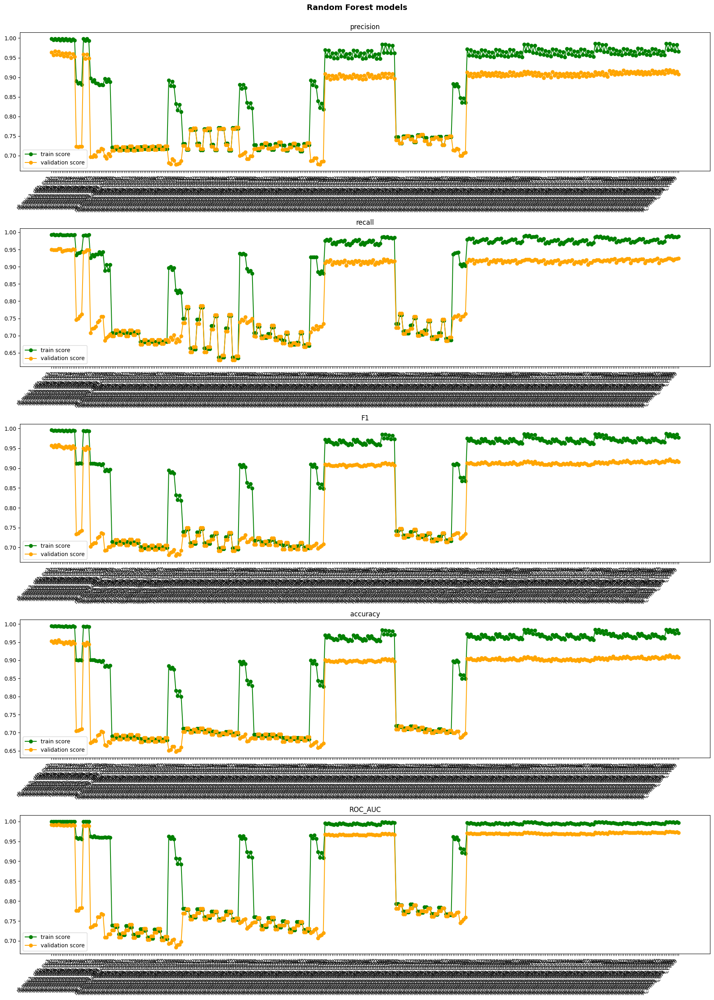

In [32]:
##############################################
#Show Trian and Validation Results
##############################################
fig, axs = plt.subplots(5, 1, figsize=(18,25))

metrics=['precision','recall', 'F1','accuracy','ROC_AUC']

for metric, ax in zip(metrics, axs.ravel()):
    #plot train scores
    ax.plot(rf_model_train_score['model'], rf_model_train_score[metric], color='green', label='train score',marker='o')
    #plot validation scores
    ax.plot(rf_model_val_score['model'], rf_model_val_score[metric], color='orange', label='validation score',marker='o')
    ax.set_title(metric)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    ax.legend()

plt.suptitle('Random Forest models',y=1,fontsize=14,fontweight='bold')
plt.tight_layout()
plt.show()


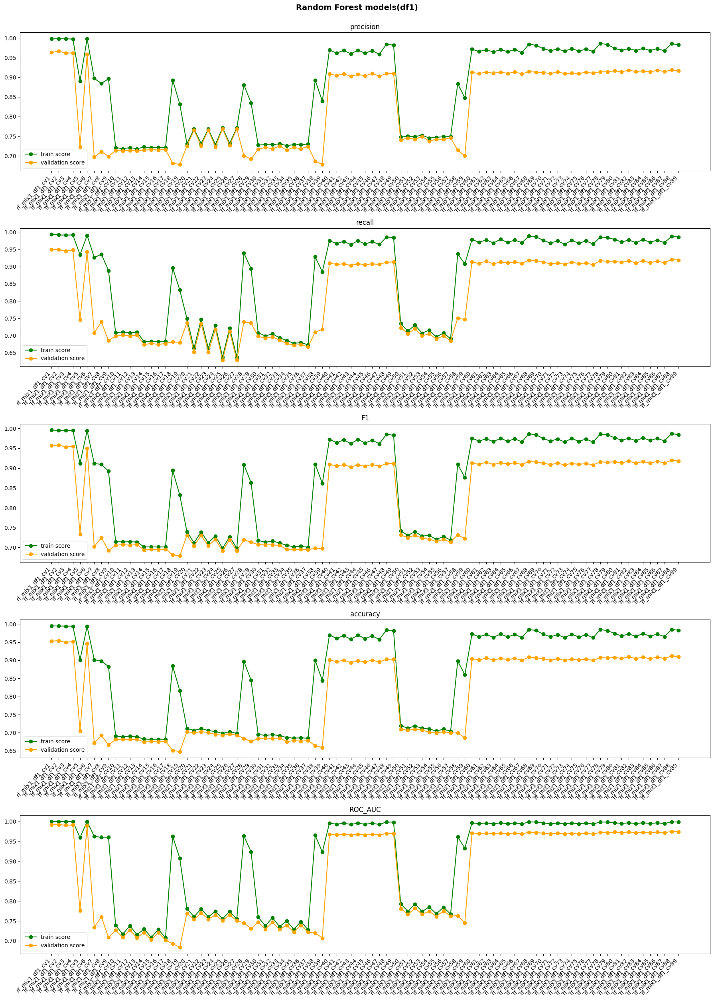

In [33]:
##############################################
#Show Trian and Validation Results
#df1
##############################################
fig, axs = plt.subplots(5, 1, figsize=(18,25))

metrics=['precision','recall', 'F1','accuracy','ROC_AUC']
mask_train=rf_model_train_score['model'].str.contains('df1')
mask_val=rf_model_val_score['model'].str.contains('df1')

for metric, ax in zip(metrics, axs.ravel()):
    #plot train scores
    ax.plot(rf_model_train_score[mask_train]['model'], rf_model_train_score[mask_train][metric], color='green', label='train score',marker='o')
    #plot validation scores
    ax.plot(rf_model_val_score[mask_val]['model'], rf_model_val_score[mask_val][metric], color='orange', label='validation score',marker='o')
    ax.set_title(metric)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    ax.legend()

plt.suptitle('Random Forest models(df1)',y=1,fontsize=14,fontweight='bold')
plt.tight_layout()
plt.show()


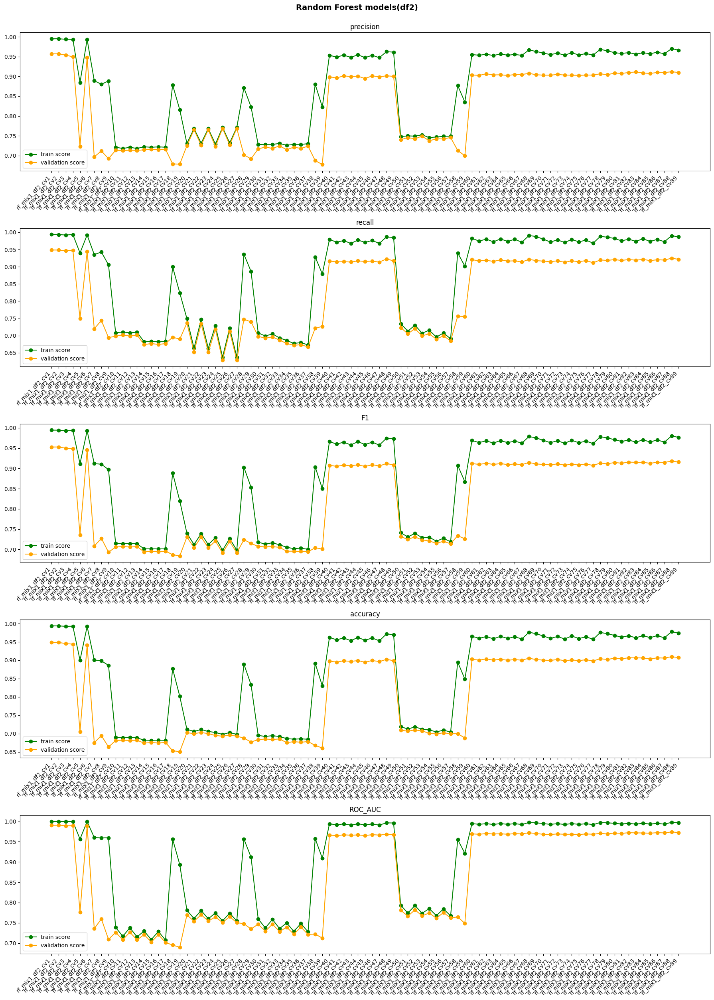

In [34]:
##############################################
#Show Trian and Validation Results
#df2
##############################################
fig, axs = plt.subplots(5, 1, figsize=(18,25))

metrics=['precision','recall', 'F1','accuracy','ROC_AUC']
mask_train=rf_model_train_score['model'].str.contains('df2')
mask_val=rf_model_val_score['model'].str.contains('df2')

for metric, ax in zip(metrics, axs.ravel()):
    #plot train scores
    ax.plot(rf_model_train_score[mask_train]['model'], rf_model_train_score[mask_train][metric], color='green', label='train score',marker='o')
    #plot validation scores
    ax.plot(rf_model_val_score[mask_val]['model'], rf_model_val_score[mask_val][metric], color='orange', label='validation score',marker='o')
    ax.set_title(metric)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    ax.legend()

plt.suptitle('Random Forest models(df2)',y=1,fontsize=14,fontweight='bold')
plt.tight_layout()
plt.show()


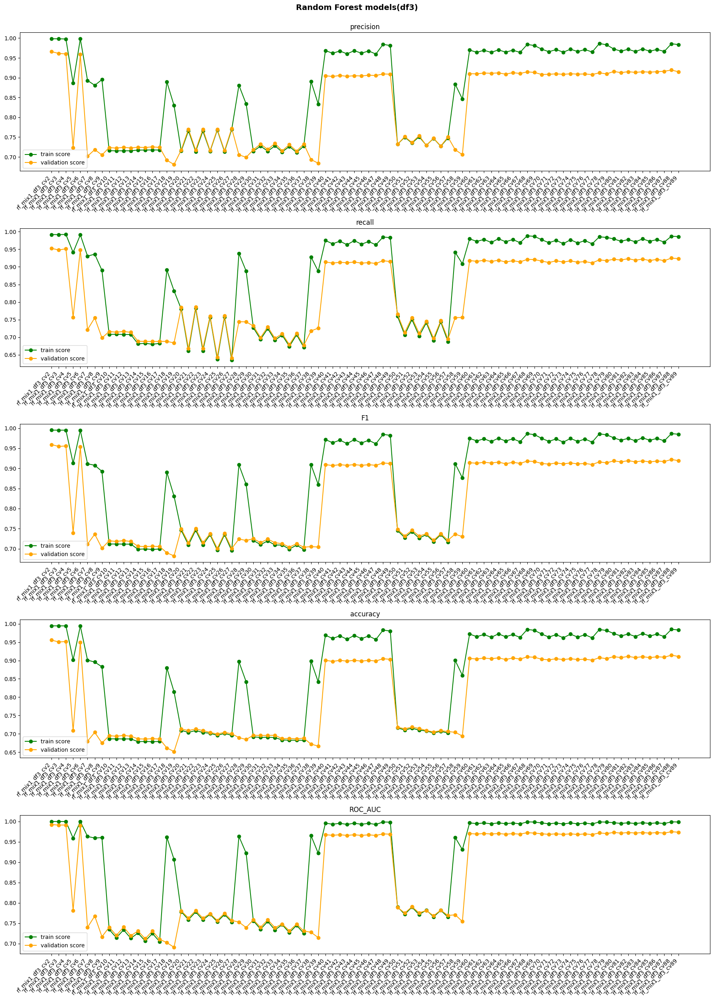

In [35]:
##############################################
#Show Trian and Validation Results
#df3
##############################################
fig, axs = plt.subplots(5, 1, figsize=(18,25))

metrics=['precision','recall', 'F1','accuracy','ROC_AUC']
mask_train=rf_model_train_score['model'].str.contains('df3')
mask_val=rf_model_val_score['model'].str.contains('df3')

for metric, ax in zip(metrics, axs.ravel()):
    #plot train scores
    ax.plot(rf_model_train_score[mask_train]['model'], rf_model_train_score[mask_train][metric], color='green', label='train score',marker='o')
    #plot validation scores
    ax.plot(rf_model_val_score[mask_val]['model'], rf_model_val_score[mask_val][metric], color='orange', label='validation score',marker='o')
    ax.set_title(metric)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    ax.legend()

plt.suptitle('Random Forest models(df3)',y=1,fontsize=14,fontweight='bold')
plt.tight_layout()
plt.show()


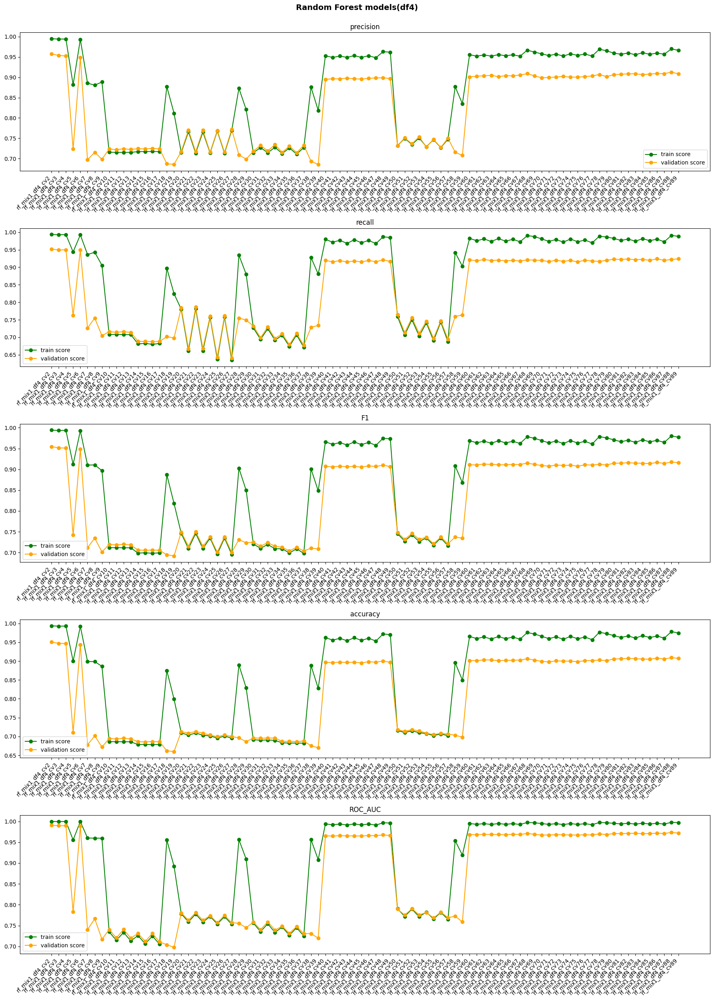

In [36]:
##############################################
#Show Trian and Validation Results
#df4
##############################################
fig, axs = plt.subplots(5, 1, figsize=(18,25))

metrics=['precision','recall', 'F1','accuracy','ROC_AUC']
mask_train=rf_model_train_score['model'].str.contains('df4')
mask_val=rf_model_val_score['model'].str.contains('df4')

for metric, ax in zip(metrics, axs.ravel()):
    #plot train scores
    ax.plot(rf_model_train_score[mask_train]['model'], rf_model_train_score[mask_train][metric], color='green', label='train score',marker='o')
    #plot validation scores
    ax.plot(rf_model_val_score[mask_val]['model'], rf_model_val_score[mask_val][metric], color='orange', label='validation score',marker='o')
    ax.set_title(metric)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    ax.legend()

plt.suptitle('Random Forest models(df4)',y=1,fontsize=14,fontweight='bold')
plt.tight_layout()
plt.show()


In [37]:
###################################################
#Get Tree depth
###################################################
df_depth_leaves_list=[]
feature_len=len(select_col_list)
target_len=len(depedent_variables)
df_index_list=[1,2,3,4]
for target_index in range(1,target_len+1):
    for feature_index in range(1,feature_len+1):
        for df_index in df_index_list:
            com_model_name='rf_mix'+str(target_index)+'_df'+str(df_index)+'_cv'+str(feature_index)
            if com_model_name in rf_model_nm_list:
                max_depths = []
                num_leaves = []
                model_index=rf_model_nm_list.index(com_model_name)
                rf_model=rf_model_list[model_index]
                individual_trees = rf_model.named_steps['classifier'].estimators_
                for i, tree in enumerate(individual_trees):
                    current_depth = tree.get_depth()
                    current_n_leaves = tree.get_n_leaves()
                
                    max_depths.append(current_depth)
                    num_leaves.append(current_n_leaves)
                model_depth_max=np.max(max_depths)
                model_leaves_max=np.max(num_leaves)
                model_depth_mean=np.mean(max_depths)
                model_leaves_mean=np.mean(num_leaves)
            else:
                model_depth_max='N/A'
                model_leaves_max='N/A'
                model_depth_mean='N/A'
                model_leaves_mean='N/A'
            if df_index==1:
                df1_depth_max=model_depth_max
                df1_leaves_max=model_leaves_max
                df1_depth_mean=model_depth_mean
                df1_leaves_mean=model_leaves_mean
            elif df_index==2:
                df2_depth_max=model_depth_max
                df2_leaves_max=model_leaves_max
                df2_depth_mean=model_depth_mean
                df2_leaves_mean=model_leaves_mean
            elif df_index==3:
                df3_depth_max=model_depth_max
                df3_leaves_max=model_leaves_max
                df3_depth_mean=model_depth_mean
                df3_leaves_mean=model_leaves_mean
            elif df_index==4:
                df4_depth_max=model_depth_max
                df4_leaves_max=model_leaves_max
                df4_depth_mean=model_depth_mean
                df4_leaves_mean=model_leaves_mean
        df_row=pd.DataFrame(
            {
            'target index': [target_index],
            'feature index': [feature_index],
            'df1 max depth': [df1_depth_max],
            'df1 max leaves': [df1_leaves_max],
            'df1 mean depth': [df1_depth_mean],
            'df1 mean leaves': [df1_leaves_mean],
            'df2 max depth': [df2_depth_max],
            'df2 max leaves': [df2_leaves_max],
            'df2 mean depth': [df2_depth_mean],
            'df2 mean leaves': [df2_leaves_mean],
            'df3 max depth': [df3_depth_max],
            'df3 max leaves': [df3_leaves_max],
            'df3 mean depth': [df3_depth_mean],
            'df3 mean leaves': [df3_leaves_mean],
            'df4 max depth': [df4_depth_max],
            'df4 max leaves': [df4_leaves_max],
            'df4 mean depth': [df4_depth_mean],
            'df4 mean leaves': [df4_leaves_mean],
            })
        df_depth_leaves_list.append(df_row)

df_depth_leaves=pd.concat(df_depth_leaves_list).reset_index(drop=True)
df_depth_leaves.to_csv('df_depth_leaves.csv', index=False)
df_depth_leaves


,target index,feature index,df1 max depth,df1 max leaves,df1 mean depth,df1 mean leaves,df2 max depth,df2 max leaves,df2 mean depth,df2 mean leaves,df3 max depth,df3 max leaves,df3 mean depth,df3 mean leaves,df4 max depth,df4 max leaves,df4 mean depth,df4 mean leaves
0,1,1,20,4644,20.00,4048.24,20,5764,20.00,4807.00,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A
1,1,2,20,4641,20.00,3984.54,20,5692,20.00,4894.96,20,4567,20.0,3967.29,20,5583,20.0,4858.21
2,1,3,20,4667,20.00,4228.39,20,5969,20.00,5115.11,20,5023,20.0,4242.34,20,5963,20.0,5101.75
3,1,4,20,4577,20.00,4074.42,20,5759,20.00,4988.26,20,4628,20.0,4047.02,20,5916,20.0,4996.77
4,1,5,20,10615,20.00,8920.35,20,10704,20.00,8822.04,20,10835,20.0,8979.49,20,10924,20.0,8914.84
5,1,6,20,4864,20.00,4207.68,20,5887,20.00,5092.49,20,4901,20.0,4200.61,20,6078,20.0,5054.0
6,1,7,20,11789,20.00,10182.56,20,11866,20.00,10215.53,20,11864,20.0,10365.55,20,12320,20.0,10316.84
7,1,8,20,10432,20.00,9160.58,20,10794,20.00,9356.44,20,10754,20.0,9167.77,20,10750,20.0,9470.89
8,1,9,20,11647,20.00,10379.19,20,12366,20.00,10684.19,20,11764,20.0,10349.67,20,12276,20.0,10698.11
9,1,10,14,294,12.14,281.95,15,297,14.85,287.96,13,290,12.09,280.62,15,298,14.86,289.39


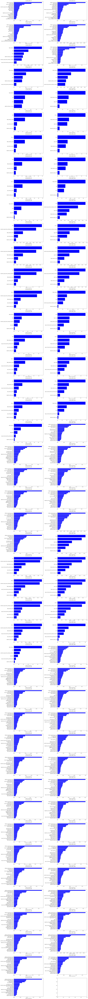

In [38]:
#############################################################
#Plot feature importance
#df1
#############################################################
rf_model_list_df1=[]
rf_model_nm_list_df1=[]

for rf_model, rf_name in zip(rf_model_list,rf_model_nm_list):
    if 'df1' in rf_name:
        rf_model_list_df1.append(rf_model) 
        rf_model_nm_list_df1.append(rf_name) 

rowCount=math.ceil(len(rf_model_list_df1)/2)
fig, axes = plt.subplots(nrows=rowCount, ncols=2, figsize=(20,rowCount*5))

for rf_model, ax, index in zip(rf_model_list_df1, axes.flatten(), range(len(rf_model_list_df1))):
    rf_best=rf_model.named_steps['classifier']
    model_name=rf_model_nm_list_df1[index]
    if type(rf_best)==Pipeline:
        importances=rf_best.named_steps["classifier"].feature_importances_
    else:
        importances = rf_best.feature_importances_

    #pickle file rf_[dummy|label]_cvXX_hyp*_gs* XX is index
    params_index=find_number(model_name, '_cv')[0]-1
    select_col=select_col_list[params_index].copy()

    if 'rf_mix' in model_name:
        df_index=find_number(model_name, '_df')[0]-1
        X_train=X_train_list[df_index]
        y_train=y_train_list[df_index]
        features=get_fit_features(select_col,X_train.columns)
        #features=get_fit_features(select_col,X_val.columns)

    indices = np.argsort(importances)

    # customized number
    if len(importances)>=20:
        num_features = 20
    else:
        num_features =len(importances)

    ax.set_title(model_name)
    # only plot the customized number of features
    ax.barh(range(num_features), importances[indices[-num_features:]], color='b', align='center')
    ax.set_xlabel('Relative Importance')

    ax.set_yticks(range(num_features))
    ax.set_yticklabels([features[i] for i in indices[-num_features:]])

plt.tight_layout()
plt.show()

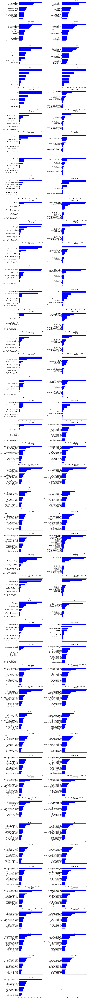

In [39]:
#############################################################
#Plot feature importance
#df2
#############################################################
rf_model_list_df2=[]
rf_model_nm_list_df2=[]

for rf_model, rf_name in zip(rf_model_list,rf_model_nm_list):
    if 'df2' in rf_name:
        rf_model_list_df2.append(rf_model) 
        rf_model_nm_list_df2.append(rf_name) 

rowCount=math.ceil(len(rf_model_list_df2)/2)
fig, axes = plt.subplots(nrows=rowCount, ncols=2, figsize=(20,rowCount*5))

for rf_model, ax, index in zip(rf_model_list_df2, axes.flatten(), range(len(rf_model_list_df2))):
    rf_best=rf_model.named_steps['classifier']
    model_name=rf_model_nm_list_df2[index]
    if type(rf_best)==Pipeline:
        importances=rf_best.named_steps["classifier"].feature_importances_
    else:
        importances = rf_best.feature_importances_

    #pickle file rf_[dummy|label]_cvXX_hyp*_gs* XX is index
    params_index=find_number(model_name, '_cv')[0]-1
    select_col=select_col_list[params_index].copy()

    if 'rf_mix' in model_name:
        df_index=find_number(model_name, '_df')[0]-1
        X_train=X_train_list[df_index]
        y_train=y_train_list[df_index]
        features=get_fit_features(select_col,X_train.columns)
        #features=get_fit_features(select_col,X_val.columns)

    indices = np.argsort(importances)

    # customized number
    if len(importances)>=20:
        num_features = 20
    else:
        num_features =len(importances)

    ax.set_title(model_name)
    # only plot the customized number of features
    ax.barh(range(num_features), importances[indices[-num_features:]], color='b', align='center')
    ax.set_xlabel('Relative Importance')

    ax.set_yticks(range(num_features))
    ax.set_yticklabels([features[i] for i in indices[-num_features:]])

plt.tight_layout()
plt.show()

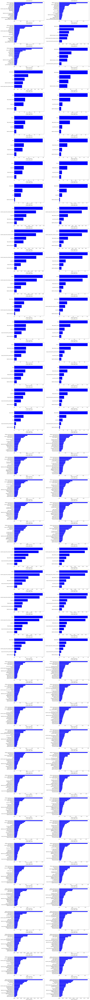

In [40]:
#############################################################
#Plot feature importance
#df3
#############################################################
rf_model_list_df3=[]
rf_model_nm_list_df3=[]

for rf_model, rf_name in zip(rf_model_list,rf_model_nm_list):
    if 'df3' in rf_name:
        rf_model_list_df3.append(rf_model) 
        rf_model_nm_list_df3.append(rf_name) 

rowCount=math.ceil(len(rf_model_list_df3)/2)
fig, axes = plt.subplots(nrows=rowCount, ncols=2, figsize=(20,rowCount*5))

for rf_model, ax, index in zip(rf_model_list_df3, axes.flatten(), range(len(rf_model_list_df3))):
    rf_best=rf_model.named_steps['classifier']
    model_name=rf_model_nm_list_df3[index]
    if type(rf_best)==Pipeline:
        importances=rf_best.named_steps["classifier"].feature_importances_
    else:
        importances = rf_best.feature_importances_

    #pickle file rf_[dummy|label]_cvXX_hyp*_gs* XX is index
    params_index=find_number(model_name, '_cv')[0]-1
    select_col=select_col_list[params_index].copy()

    if 'rf_mix' in model_name:
        df_index=find_number(model_name, '_df')[0]-1
        X_train=X_train_list[df_index]
        y_train=y_train_list[df_index]
        features=get_fit_features(select_col,X_train.columns)
        #features=get_fit_features(select_col,X_val.columns)

    indices = np.argsort(importances)

    # customized number
    if len(importances)>=20:
        num_features = 20
    else:
        num_features =len(importances)

    ax.set_title(model_name)
    # only plot the customized number of features
    ax.barh(range(num_features), importances[indices[-num_features:]], color='b', align='center')
    ax.set_xlabel('Relative Importance')

    ax.set_yticks(range(num_features))
    ax.set_yticklabels([features[i] for i in indices[-num_features:]])

plt.tight_layout()
plt.show()

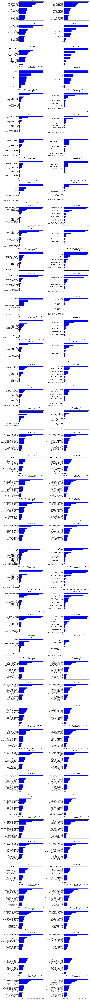

In [41]:
#############################################################
#Plot feature importance
#df4
#############################################################
rf_model_list_df4=[]
rf_model_nm_list_df4=[]

for rf_model, rf_name in zip(rf_model_list,rf_model_nm_list):
    if 'df4' in rf_name:
        rf_model_list_df4.append(rf_model) 
        rf_model_nm_list_df4.append(rf_name) 

rowCount=math.ceil(len(rf_model_list_df4)/2)
fig, axes = plt.subplots(nrows=rowCount, ncols=2, figsize=(20,rowCount*5))

for rf_model, ax, index in zip(rf_model_list_df4, axes.flatten(), range(len(rf_model_list_df4))):
    rf_best=rf_model.named_steps['classifier']
    model_name=rf_model_nm_list_df4[index]
    if type(rf_best)==Pipeline:
        importances=rf_best.named_steps["classifier"].feature_importances_
    else:
        importances = rf_best.feature_importances_

    #pickle file rf_[dummy|label]_cvXX_hyp*_gs* XX is index
    params_index=find_number(model_name, '_cv')[0]-1
    select_col=select_col_list[params_index].copy()

    if 'rf_mix' in model_name:
        df_index=find_number(model_name, '_df')[0]-1
        X_train=X_train_list[df_index]
        y_train=y_train_list[df_index]
        features=get_fit_features(select_col,X_train.columns)
        #features=get_fit_features(select_col,X_val.columns)

    indices = np.argsort(importances)

    # customized number
    if len(importances)>=20:
        num_features = 20
    else:
        num_features =len(importances)

    ax.set_title(model_name)
    # only plot the customized number of features
    ax.barh(range(num_features), importances[indices[-num_features:]], color='b', align='center')
    ax.set_xlabel('Relative Importance')

    ax.set_yticks(range(num_features))
    ax.set_yticklabels([features[i] for i in indices[-num_features:]])

plt.tight_layout()
plt.show()

## Tune Hyperparmeter

* df2 and df4 appeared to have lower score, more leaf nodes than df1 and df3. df3 dropped columns, which has more data than df1, tune df3
    * df1 and df3: ordinal encoding
    * df2 and df4: One-Hot encoding(needs more leaf nodes)
* select_col_list [1] was for comparison purpose, no need to tune
* Tune df1 and df3, select_col_list [2-89] 


In this scenario, assume we need to balance false positive and false positive<BR/>
use `f1` to refit


In [42]:
rf_cv_params_list=[
    #index:1
    {'max_depth': [7,9,11,13,15], 
     'min_samples_leaf': [1],
     'min_samples_split': [2],
     'max_features': [0.4, 0.5, 0.6, 0.7, 0.8, 0.9,1],
     'max_samples': [0.3, 0.5, 0.7, 0.9],
     'n_estimators': [80, 120, 160],
     'class_weight':[None],
    },
    #index:2
    {'max_depth': [7,11,15], 
     'min_samples_leaf': [5,10,20],
     'min_samples_split': [10,20,50],
     'max_features': [0.3, 0.5, 0.7, 0.9],
     'max_samples': [0.3, 0.5, 0.7, 0.9],
     'n_estimators': [120, 160],
     'class_weight':[None],
    },
]


rf=RandomForestClassifier(random_state=0)
rf_model = Pipeline(steps=[
                        ('classifier', rf)])

In [43]:
%%script True
####################################################
#target_index:[1]
#df_index:[1,3]
#feature_index:[2-89]
#hyparameter index: [1]
#GridSearchCV index: [1]
#cv:5
####################################################
target_index_list=[1]
feature_index_list=range(2,len(select_col_list)+1)
#feature_index_list=[2]
df_index_list=[3]
#hyparameter index,start from 1
hyp_index_list=[1]

for target_index in target_index_list:
    for df_index in df_index_list:
        for feature_index in feature_index_list:
            for hyp_index in hyp_index_list:
                rf_grid_fit(target_index,df_index,feature_index, hyp_index, 1, encoding_type='mix',rf_classifier=rf_model,cv=5, refit='f1')

Couldn't find program: 'True'


In [44]:
%%script True
####################################################
#target_index:[1]
#df_index:[1,3]
#feature_index:[2-89]
#hyparameter index: [1]
#GridSearchCV index: [1]
#cv:5
####################################################
target_index_list=[1]
#feature_index_list=range(65,len(select_col_list)+1)
#feature_index_list=range(80,len(select_col_list)+1)
#feature_index_list=range(72,81)
#feature_index_list=[89,79,78]
#feature_index_list=[2]
df_index_list=[3]
#hyparameter index,start from 1
hyp_index_list=[1]

for target_index in target_index_list:
    for df_index in df_index_list:
        for feature_index in feature_index_list:
            for hyp_index in hyp_index_list:
                rf_grid_fit(target_index,df_index,feature_index, hyp_index, 1, encoding_type='mix',rf_classifier=rf_model,cv=5, refit='f1')

Couldn't find program: 'True'


In [45]:
#rf_mix1_df3_cv2_hyp2_gs1 
#rf_grid_fit(target_index=1,df_index=3,feature_index=2, hyp_index=2, gs_index=1, encoding_type='mix',rf_classifier=rf_model,cv=5, refit='f1')

#rf_mix1_df3_cv3_hyp2_gs1
#rf_grid_fit(target_index=1,df_index=3,feature_index=3, hyp_index=2, gs_index=1, encoding_type='mix',rf_classifier=rf_model,cv=5, refit='f1')

#rf_mix1_df3_cv4_hyp2_gs1
#rf_grid_fit(target_index=1,df_index=3,feature_index=4, hyp_index=2, gs_index=1, encoding_type='mix',rf_classifier=rf_model,cv=5, refit='f1')

#rf_mix1_df3_cv6_hyp2_gs1
#rf_grid_fit(target_index=1,df_index=3,feature_index=6, hyp_index=2, gs_index=1, encoding_type='mix',rf_classifier=rf_model,cv=5, refit='f1')

#rf_mix1_df3_cv39_hyp2_gs1
#rf_grid_fit(target_index=1,df_index=3,feature_index=39, hyp_index=2, gs_index=1, encoding_type='mix',rf_classifier=rf_model,cv=5, refit='f1')

#rf_mix1_df3_cv9_hyp2_gs1
#rf_grid_fit(target_index=1,df_index=3,feature_index=9, hyp_index=2, gs_index=1, encoding_type='mix',rf_classifier=rf_model,cv=5, refit='f1')


## Results and Evaluation

### [Random Forest](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html#sklearn.ensemble.RandomForestClassifier.get_params)

In [46]:
###################################################
#Read from pickle
###################################################
target_len=len(depedent_variables)
#feature_len=len(select_col_list)
feature_len=list(range(2,len(select_col_list)+1))
#feature_index_list=model_feature_index
df_len=len(df_encode_list)
#feature_len=1
hyp_len=len(rf_cv_params_list)
gs_len=5
encoding_type='mix'
rf_cv_list,rf_model_name_list=rf_read_pickle(target_len,[3],feature_len, hyp_len, gs_len, encoding_type,path_rf)

In [47]:
###################################################
#Examine the best combination of hyperparameters.
###################################################
rf_best_hyperparameters=pd.DataFrame()
for index in range(len(rf_cv_list)):
    rf_row=rf_cv_list[index].best_params_
    rf_row['rf Model name']=rf_model_name_list[index]
    df_dictionary = pd.DataFrame([rf_row])
    rf_best_hyperparameters = pd.concat([rf_best_hyperparameters, df_dictionary], ignore_index=True)

rf_best_hyperparameters.to_csv('rf_best_hyperparameters.csv', index=False)
rf_best_hyperparameters

,classifier__class_weight,classifier__max_depth,classifier__max_features,classifier__max_samples,classifier__min_samples_leaf,classifier__min_samples_split,classifier__n_estimators,rf Model name
0,None,15,0.6,0.9,1,2,160,rf_mix1_df3_cv2_hyp1_gs1
1,None,15,0.7,0.9,5,10,160,rf_mix1_df3_cv2_hyp2_gs1
2,None,15,0.6,0.9,1,2,160,rf_mix1_df3_cv3_hyp1_gs1
3,None,15,0.5,0.9,5,10,160,rf_mix1_df3_cv3_hyp2_gs1
4,None,15,0.5,0.9,1,2,160,rf_mix1_df3_cv4_hyp1_gs1
5,None,15,0.7,0.9,5,10,160,rf_mix1_df3_cv4_hyp2_gs1
6,None,13,0.5,0.7,1,2,160,rf_mix1_df3_cv5_hyp1_gs1
7,None,15,0.6,0.9,1,2,160,rf_mix1_df3_cv6_hyp1_gs1
8,None,15,0.7,0.9,5,10,160,rf_mix1_df3_cv6_hyp2_gs1
9,None,13,0.4,0.3,1,2,80,rf_mix1_df3_cv7_hyp1_gs1


In [48]:
#show df1:X_list[0]
rf_best_hyperparameters[rf_best_hyperparameters['rf Model name'].str.contains('df1')]

,classifier__class_weight,classifier__max_depth,classifier__max_features,classifier__max_samples,classifier__min_samples_leaf,classifier__min_samples_split,classifier__n_estimators,rf Model name


In [49]:
#show df2:X_list[1]
rf_best_hyperparameters[rf_best_hyperparameters['rf Model name'].str.contains('df2')]

,classifier__class_weight,classifier__max_depth,classifier__max_features,classifier__max_samples,classifier__min_samples_leaf,classifier__min_samples_split,classifier__n_estimators,rf Model name


In [50]:
#show df3:X_list[2]
rf_best_hyperparameters[rf_best_hyperparameters['rf Model name'].str.contains('df3')]

,classifier__class_weight,classifier__max_depth,classifier__max_features,classifier__max_samples,classifier__min_samples_leaf,classifier__min_samples_split,classifier__n_estimators,rf Model name
0,None,15,0.6,0.9,1,2,160,rf_mix1_df3_cv2_hyp1_gs1
1,None,15,0.7,0.9,5,10,160,rf_mix1_df3_cv2_hyp2_gs1
2,None,15,0.6,0.9,1,2,160,rf_mix1_df3_cv3_hyp1_gs1
3,None,15,0.5,0.9,5,10,160,rf_mix1_df3_cv3_hyp2_gs1
4,None,15,0.5,0.9,1,2,160,rf_mix1_df3_cv4_hyp1_gs1
5,None,15,0.7,0.9,5,10,160,rf_mix1_df3_cv4_hyp2_gs1
6,None,13,0.5,0.7,1,2,160,rf_mix1_df3_cv5_hyp1_gs1
7,None,15,0.6,0.9,1,2,160,rf_mix1_df3_cv6_hyp1_gs1
8,None,15,0.7,0.9,5,10,160,rf_mix1_df3_cv6_hyp2_gs1
9,None,13,0.4,0.3,1,2,80,rf_mix1_df3_cv7_hyp1_gs1


In [51]:
#show df4:X_list[3]
rf_best_hyperparameters[rf_best_hyperparameters['rf Model name'].str.contains('df4')]

,classifier__class_weight,classifier__max_depth,classifier__max_features,classifier__max_samples,classifier__min_samples_leaf,classifier__min_samples_split,classifier__n_estimators,rf Model name


In [52]:
###################################################
#Training Results
###################################################
rf_train_score_list=[]
for rf_cv, index in zip(rf_cv_list, range(len(rf_cv_list))):
    rf_best=rf_cv.best_estimator_
    model_name=rf_model_name_list[index]
    #pickle file rf_[dummy|label]_cvXX_hyp*_gs* XX was index
    params_index=find_number(model_name, '_cv')[0]-1
    select_col=select_col_list[params_index].copy()

    if 'rf_mix' in model_name:
        target_index=find_number(model_name, 'rf_mix')[0]-1
        df_index=find_number(model_name, '_df')[0]-1
        X_train=X_train_list[df_index]
        y_train=y_train_list[df_index]
        select_features=get_fit_features(select_col,X_train.columns)
        #print(model_name,select_col,select_features,df_index)
        rf_y_preds=rf_best.predict(X_train[select_features])
        rf_y_proba= rf_best.predict_proba(X_train[select_features])
        num_params=len(select_col)
        train_score=get_test_scores(model_name, rf_y_preds, y_train,rf_y_proba[:,1])
    rf_train_score_list.append(train_score)

rf_train_score=pd.concat(rf_train_score_list).reset_index(drop=True)
rf_train_score.to_csv('rf_train_score.csv', index=False)
rf_train_score

,model,precision,recall,F1,accuracy,ROC_AUC
0,rf_mix1_df3_cv2_hyp1_gs1,0.989330,0.971772,0.980472,0.978814,0.997986
1,rf_mix1_df3_cv2_hyp2_gs1,0.981797,0.962346,0.971975,0.969626,0.996397
2,rf_mix1_df3_cv3_hyp1_gs1,0.988153,0.968020,0.977983,0.976145,0.997558
3,rf_mix1_df3_cv3_hyp2_gs1,0.977853,0.956508,0.967063,0.964339,0.995217
4,rf_mix1_df3_cv4_hyp1_gs1,0.984470,0.972006,0.978198,0.976286,0.997540
5,rf_mix1_df3_cv4_hyp2_gs1,0.976104,0.961526,0.968760,0.966058,0.995793
6,rf_mix1_df3_cv5_hyp1_gs1,0.784836,0.809622,0.797036,0.774317,0.850560
7,rf_mix1_df3_cv6_hyp1_gs1,0.985819,0.964879,0.975236,0.973180,0.997168
8,rf_mix1_df3_cv6_hyp2_gs1,0.976090,0.955196,0.965529,0.962671,0.995125
9,rf_mix1_df3_cv7_hyp1_gs1,0.763220,0.767139,0.765174,0.742288,0.814314


In [53]:
#show df1:X_list[0]
rf_train_score[rf_train_score['model'].str.contains('df1')]

,model,precision,recall,F1,accuracy,ROC_AUC


In [54]:
#show df2:X_list[1]
rf_train_score[rf_train_score['model'].str.contains('df2')]

,model,precision,recall,F1,accuracy,ROC_AUC


In [55]:
#show df3:X_list[2]
rf_train_score[rf_train_score['model'].str.contains('df3')]

,model,precision,recall,F1,accuracy,ROC_AUC
0,rf_mix1_df3_cv2_hyp1_gs1,0.989330,0.971772,0.980472,0.978814,0.997986
1,rf_mix1_df3_cv2_hyp2_gs1,0.981797,0.962346,0.971975,0.969626,0.996397
2,rf_mix1_df3_cv3_hyp1_gs1,0.988153,0.968020,0.977983,0.976145,0.997558
3,rf_mix1_df3_cv3_hyp2_gs1,0.977853,0.956508,0.967063,0.964339,0.995217
4,rf_mix1_df3_cv4_hyp1_gs1,0.984470,0.972006,0.978198,0.976286,0.997540
5,rf_mix1_df3_cv4_hyp2_gs1,0.976104,0.961526,0.968760,0.966058,0.995793
6,rf_mix1_df3_cv5_hyp1_gs1,0.784836,0.809622,0.797036,0.774317,0.850560
7,rf_mix1_df3_cv6_hyp1_gs1,0.985819,0.964879,0.975236,0.973180,0.997168
8,rf_mix1_df3_cv6_hyp2_gs1,0.976090,0.955196,0.965529,0.962671,0.995125
9,rf_mix1_df3_cv7_hyp1_gs1,0.763220,0.767139,0.765174,0.742288,0.814314


In [56]:
#show df4:X_list[3]
rf_train_score[rf_train_score['model'].str.contains('df4')]

,model,precision,recall,F1,accuracy,ROC_AUC


In [57]:
###################################################
#Validation Results
###################################################
rf_val_score_list=[]
for rf_cv, index in zip(rf_cv_list, range(len(rf_cv_list))):
    rf_best=rf_cv.best_estimator_
    model_name=rf_model_name_list[index]
    #pickle file rf_[dummy|label]_cvXX_hyp*_gs* XX was index
    params_index=find_number(model_name, '_cv')[0]-1
    select_col=select_col_list[params_index].copy()
    
    if 'rf_mix' in model_name:
        target_index=find_number(model_name, 'rf_mix')[0]-1
        df_index=find_number(model_name, '_df')[0]-1
        X_val=X_val_list[df_index]
        y_val=y_val_list[df_index]
        select_features=get_fit_features(select_col,X_val.columns)
        rf_y_preds=rf_best.predict(X_val[select_features])
        rf_y_proba= rf_best.predict_proba(X_val[select_features])
        num_params=len(select_col)
        val_score=get_test_scores(model_name, rf_y_preds, y_val,rf_y_proba[:,1])
    rf_val_score_list.append(val_score)

rf_val_score=pd.concat(rf_val_score_list).reset_index(drop=True)
rf_val_score.to_csv('rf_val_score.csv', index=False)
rf_val_score

,model,precision,recall,F1,accuracy,ROC_AUC
0,rf_mix1_df3_cv2_hyp1_gs1,0.967727,0.950483,0.959027,0.955549,0.992267
1,rf_mix1_df3_cv2_hyp2_gs1,0.965103,0.949264,0.957118,0.953444,0.991733
2,rf_mix1_df3_cv3_hyp1_gs1,0.962984,0.944200,0.953499,0.949594,0.990868
3,rf_mix1_df3_cv3_hyp2_gs1,0.960597,0.941949,0.951181,0.947079,0.989968
4,rf_mix1_df3_cv4_hyp1_gs1,0.959012,0.950108,0.954539,0.950467,0.991137
5,rf_mix1_df3_cv4_hyp2_gs1,0.958211,0.948326,0.953243,0.949081,0.990536
6,rf_mix1_df3_cv5_hyp1_gs1,0.741649,0.760011,0.750718,0.723745,0.799776
7,rf_mix1_df3_cv6_hyp1_gs1,0.958966,0.942418,0.950620,0.946412,0.989863
8,rf_mix1_df3_cv6_hyp2_gs1,0.957888,0.940730,0.949231,0.944924,0.989236
9,rf_mix1_df3_cv7_hyp1_gs1,0.725139,0.724186,0.724662,0.698799,0.767320


In [58]:
#show df1:X_list[0]
rf_val_score[rf_val_score['model'].str.contains('df1')]

,model,precision,recall,F1,accuracy,ROC_AUC


In [59]:
#show df2:X_list[1]
rf_val_score[rf_val_score['model'].str.contains('df2')]

,model,precision,recall,F1,accuracy,ROC_AUC


In [60]:
#show df3:X_list[2]
rf_val_score[rf_val_score['model'].str.contains('df3')]

,model,precision,recall,F1,accuracy,ROC_AUC
0,rf_mix1_df3_cv2_hyp1_gs1,0.967727,0.950483,0.959027,0.955549,0.992267
1,rf_mix1_df3_cv2_hyp2_gs1,0.965103,0.949264,0.957118,0.953444,0.991733
2,rf_mix1_df3_cv3_hyp1_gs1,0.962984,0.944200,0.953499,0.949594,0.990868
3,rf_mix1_df3_cv3_hyp2_gs1,0.960597,0.941949,0.951181,0.947079,0.989968
4,rf_mix1_df3_cv4_hyp1_gs1,0.959012,0.950108,0.954539,0.950467,0.991137
5,rf_mix1_df3_cv4_hyp2_gs1,0.958211,0.948326,0.953243,0.949081,0.990536
6,rf_mix1_df3_cv5_hyp1_gs1,0.741649,0.760011,0.750718,0.723745,0.799776
7,rf_mix1_df3_cv6_hyp1_gs1,0.958966,0.942418,0.950620,0.946412,0.989863
8,rf_mix1_df3_cv6_hyp2_gs1,0.957888,0.940730,0.949231,0.944924,0.989236
9,rf_mix1_df3_cv7_hyp1_gs1,0.725139,0.724186,0.724662,0.698799,0.767320


In [61]:
#show df4:X_list[3]
rf_val_score[rf_val_score['model'].str.contains('df4')]

,model,precision,recall,F1,accuracy,ROC_AUC


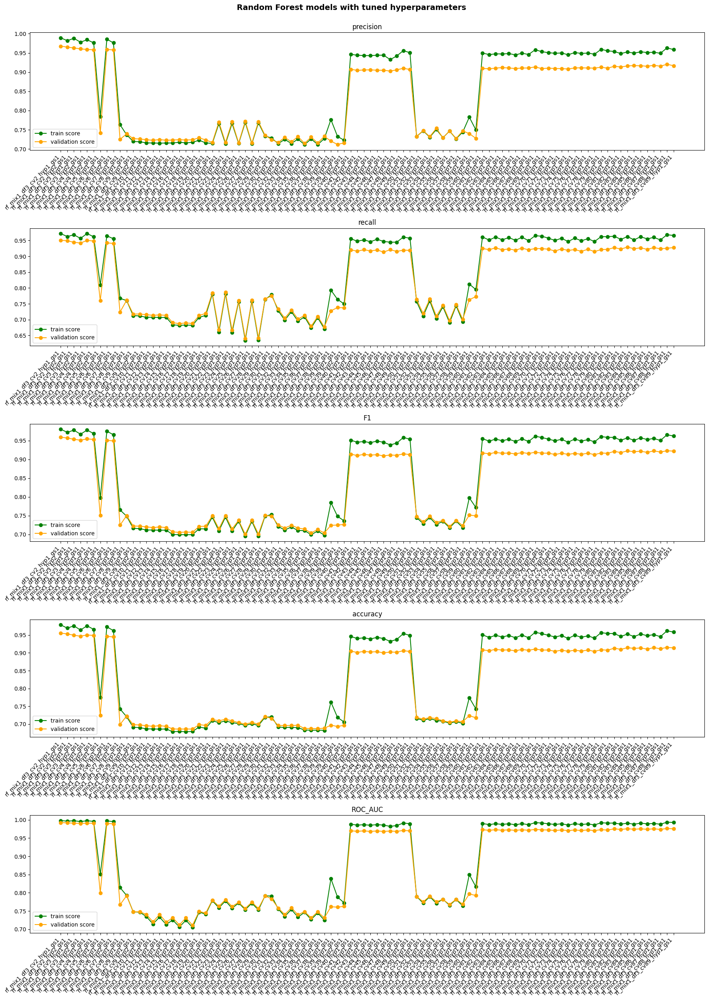

In [62]:
##############################################
#Show Trian and Validation Results
##############################################
fig, axs = plt.subplots(5, 1, figsize=(18,25))

metrics=['precision','recall', 'F1','accuracy','ROC_AUC']

for metric, ax in zip(metrics, axs.ravel()):
    #plot train scores
    ax.plot(rf_train_score['model'], rf_train_score[metric], color='green', label='train score',marker='o')
    #plot validation scores
    ax.plot(rf_val_score['model'], rf_val_score[metric], color='orange', label='validation score',marker='o')
    ax.set_title(metric)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    ax.legend()

plt.suptitle('Random Forest models with tuned hyperparameters',y=1,fontsize=14,fontweight='bold')
plt.tight_layout()
plt.show()


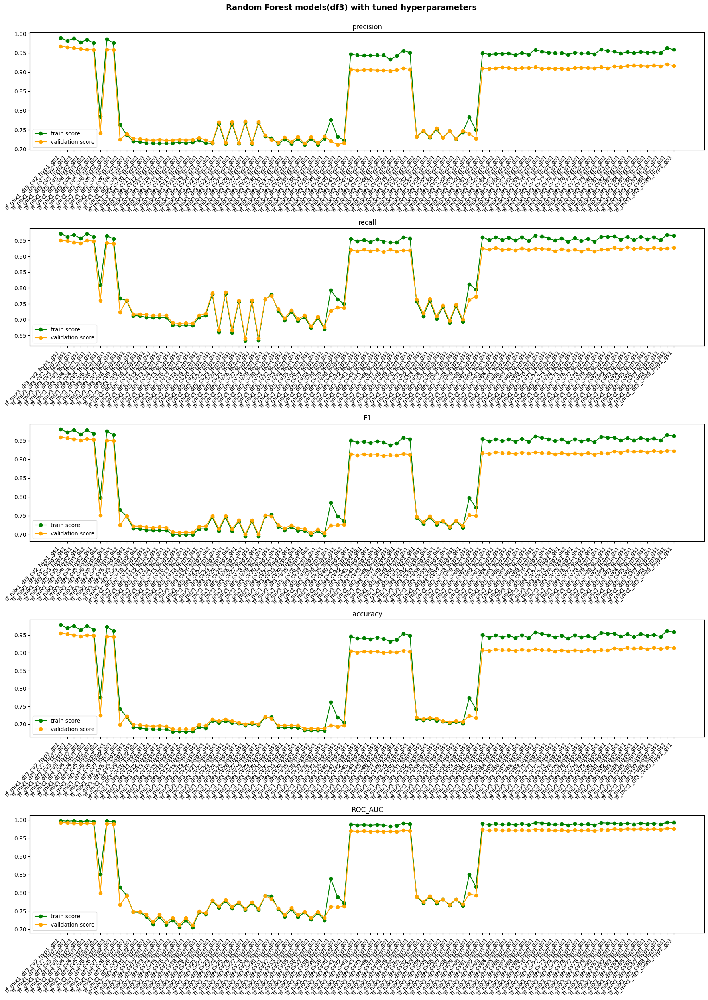

In [63]:
##############################################
#Show Trian and Validation Results
#df3
##############################################
fig, axs = plt.subplots(5, 1, figsize=(18,25))

metrics=['precision','recall', 'F1','accuracy','ROC_AUC']
mask_train=rf_train_score['model'].str.contains('df3')
mask_val=rf_val_score['model'].str.contains('df3')

for metric, ax in zip(metrics, axs.ravel()):
    #plot train scores
    ax.plot(rf_train_score[mask_train]['model'], rf_train_score[mask_train][metric], color='green', label='train score',marker='o')
    #plot validation scores
    ax.plot(rf_val_score[mask_val]['model'], rf_val_score[mask_val][metric], color='orange', label='validation score',marker='o')
    ax.set_title(metric)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
    ax.legend()

plt.suptitle('Random Forest models(df3) with tuned hyperparameters',y=1,fontsize=14,fontweight='bold')
plt.tight_layout()
plt.show()


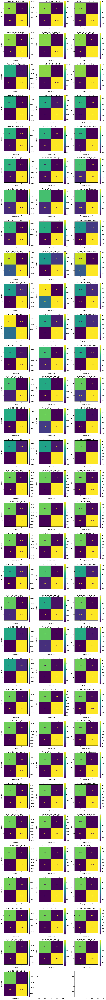

In [64]:
#################################################################################
#Display confusion on validation data
#################################################################################
rowCount=math.ceil(len(rf_cv_list)/3)
fig, axes = plt.subplots(nrows=rowCount, ncols=3, figsize=(16,rowCount*5))

for rf_cv,ax,model_index in zip(rf_cv_list,axes.ravel(),range(len(rf_cv_list))):
    model=rf_cv.best_estimator_
    rf_model_name=rf_model_name_list[model_index]
    
    params_index=find_number(rf_model_name, '_cv')[0]-1
    select_col=select_col_list[params_index].copy()
    df_index=find_number(rf_model_name, '_df')[0]-1
    X_val=X_val_list[df_index]
    y_val=y_val_list[df_index]
    select_features=get_fit_features(select_col,X_val.columns)

    confusion_matrix_plot_ax(model, X_val[select_features], y_val,ax,rf_model_name)

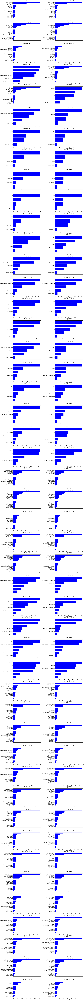

In [65]:
#############################################################
#Plot feature importance
#df3
#############################################################
rf_model_list_df3=[]
rf_model_nm_list_df3=[]

for rf_cv, rf_name in zip(rf_cv_list,rf_model_name_list):
    rf_model=rf_cv.best_estimator_
    if 'df3' in rf_name:
        rf_model_list_df3.append(rf_model) 
        rf_model_nm_list_df3.append(rf_name) 

rowCount=math.ceil(len(rf_model_list_df3)/2)
fig, axes = plt.subplots(nrows=rowCount, ncols=2, figsize=(20,rowCount*5))

for rf_model, ax, index in zip(rf_model_list_df3, axes.flatten(), range(len(rf_model_list_df3))):
    rf_best=rf_model.named_steps['classifier']
    model_name=rf_model_nm_list_df3[index]
    if type(rf_best)==Pipeline:
        importances=rf_best.named_steps["classifier"].feature_importances_
    else:
        importances = rf_best.feature_importances_

    #pickle file rf_[dummy|label]_cvXX_hyp*_gs* XX is index
    params_index=find_number(model_name, '_cv')[0]-1
    select_col=select_col_list[params_index].copy()

    if 'rf_mix' in model_name:
        df_index=find_number(model_name, '_df')[0]-1
        X_train=X_train_list[df_index]
        y_train=y_train_list[df_index]
        features=get_fit_features(select_col,X_train.columns)
        #features=get_fit_features(select_col,X_val.columns)

    indices = np.argsort(importances)

    # customized number
    if len(importances)>=20:
        num_features = 20
    else:
        num_features =len(importances)

    ax.set_title(model_name)
    # only plot the customized number of features
    ax.barh(range(num_features), importances[indices[-num_features:]], color='b', align='center')
    ax.set_xlabel('Relative Importance')

    ax.set_yticks(range(num_features))
    ax.set_yticklabels([features[i] for i in indices[-num_features:]])

plt.tight_layout()
plt.show()



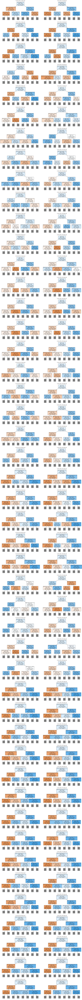

In [66]:
#############################################################
#Plot tree
#df3
#############################################################
rf_model_list_df3=[]
rf_model_nm_list_df3=[]

for rf_cv, rf_name in zip(rf_cv_list,rf_model_name_list):
    rf_model=rf_cv.best_estimator_
    if 'df3' in rf_name:
        rf_model_list_df3.append(rf_model) 
        rf_model_nm_list_df3.append(rf_name) 

colCount=2
rowCount=math.ceil(len(rf_model_list_df3)/colCount)

fig, axes = plt.subplots(nrows=rowCount, ncols=colCount, figsize=(20,rowCount*5))

for rf_model, ax, index in zip(rf_model_list_df3, axes.flatten(), range(len(rf_model_list_df3))):
    rf_best=rf_model.named_steps['classifier']
    model_name=rf_model_nm_list_df3[index]
    #pickle file rf_[dummy|label]_cvXX_hyp*_gs* XX is index
    params_index=find_number(model_name, '_cv')[0]-1
    select_col=select_col_list[params_index].copy()

    if 'rf_mix' in model_name:
        df_index=find_number(model_name, '_df')[0]-1
        X_val=X_val_list[df_index]
        y_val=y_val_list[df_index]
        select_features=get_fit_features(select_col,X_val.columns)

    #plot the first tree
    plot_tree(rf_best.estimators_[0],
                   feature_names = select_col, 
                   class_names={0:'dissatisfied', 1:'satisfied'},
                   filled = True,
                   max_depth=2,
                   fontsize=10,
                   ax = ax)
        
    ax.set_title(model_name)

plt.tight_layout()
plt.show()


# Test model on test set

* Select champion model
* Fit all train and validation data
* Validate champion model on test set

### Random Forest

In [67]:
%%script True
#########################################################
#Potential Champion model
#########################################################
#get best params
best_model_name='rf_mix1_df3_cv2_hyp1_gs1'
best_model_index=rf_model_name_list.index(best_model_name)
best_model=rf_cv_list[best_model_index]
best_params=best_model.best_params_
#remove classifier__ in resampled model
best_params = {k.replace('classifier__',''):v for k,v in best_params.items()}

#pickle file rf_[dummy|label]xx_cvXX_hyp*_gs* XX is index
params_index=find_number(best_model_name, '_cv')[0]-1
select_col=select_col_list[params_index].copy()

print(f"best hyperpatameters: {best_params}")
print(f"best features: {select_col}")
print(f"best model name: {best_model_name}")

###################################################
#Fit model and get test score
###################################################
if 'rf Model name' in best_params:
        best_params.pop('rf Model name')
rf_best = RandomForestClassifier(**best_params,
                                          random_state=RANDOM_STATE)
if 'rf_mix' in best_model_name:
    target_index=find_number(best_model_name, 'rf_mix')[0]-1
    df_index=find_number(best_model_name, '_df')[0]-1
    X_train_val=X_train_val_list[df_index]
    y_train_val=y_train_val_list[df_index]
    select_features=get_fit_features(select_col,X_train_val.columns)
    rf_best.fit(X_train_val[select_features], y_train_val)

    #get test score
    X_test=X_test_list[df_index]
    y_test=y_test_list[df_index]
    rf_y_preds=rf_best.predict(X_test[select_features])
    rf_y_proba= rf_best.predict_proba(X_test[select_features])
    test_score=get_test_scores(best_model_name, rf_y_preds, y_test,rf_y_proba[:,1])
        

rf_test_score=pd.concat([test_score]).reset_index(drop=True)
rf_test_score.to_csv('rf_test_score.csv', index=False, mode='w')
rf_test_score

Couldn't find program: 'True'


In [68]:
%%script True
###################################################
#Just see all models
###################################################
rf_all_test_score_list=[]
for rf_cv, index in zip(rf_cv_list, range(len(rf_cv_list))):
    rf_params=rf_cv.best_params_
    rf_model_name=rf_model_name_list[index]
    #remove classifier__ in resampled model
    rf_params = {k.replace('classifier__',''):v for k,v in rf_params.items()}
    if 'rf Model name' in rf_params:
        rf_params.pop('rf Model name')
    rf_classifier = RandomForestClassifier(**rf_params,
                                          random_state=RANDOM_STATE)
    #pickle file rf_[dummy|label]_cvXX_hyp*_gs* XX is index
    params_index=find_number(rf_model_name, '_cv')[0]-1
    select_col=select_col_list[params_index].copy()

    if 'rf_mix' in rf_model_name:
        target_index=find_number(rf_model_name, 'rf_mix')[0]-1
        df_index=find_number(rf_model_name, '_df')[0]-1
        X_train_val=X_train_val_list[df_index]
        y_train_val=y_train_val_list[df_index]
        select_features=get_fit_features(select_col,X_train_val.columns)
        rf_classifier.fit(X_train_val[select_features], y_train_val)

        X_test=X_test_list[df_index]
        y_test=y_test_list[df_index]
        rf_preds=rf_classifier.predict(X_test[select_features])
        rf_preds_proba=rf_classifier.predict_proba(X_test[select_features])[:, 1]
        test_score=get_test_scores(rf_model_name, rf_preds, y_test,rf_preds_proba)
        
    
    rf_all_test_score_list.append(test_score)

rf_all_test_score=pd.concat(rf_all_test_score_list).reset_index(drop=True)
rf_all_test_score.to_csv('rf_all_test_score.csv', index=False)
rf_all_test_score

Couldn't find program: 'True'


In [69]:
%%script True
#show df1:X_list[0]
rf_all_test_score[rf_all_test_score['model'].str.contains('df1')]

Couldn't find program: 'True'


In [70]:
%%script True
#show df2:X_list[1]
rf_all_test_score[rf_all_test_score['model'].str.contains('df2')]

Couldn't find program: 'True'


In [71]:
%%script True
#show df3:X_list[2]
rf_all_test_score[rf_all_test_score['model'].str.contains('df3')]

Couldn't find program: 'True'


In [72]:
%%script True
#show df4:X_list[3]
rf_all_test_score[rf_all_test_score['model'].str.contains('df4')]

Couldn't find program: 'True'


# Conclusion

* Potential Good Models

|Model Features Used|Feature Index|Potential Good Model|
|:-|:-|:-|
|customer_type+age+type_of_travel+class+flight_distance+rating items+departure_delay_in_minutes|No.2<BR/>No.80-No.89|rf_mix1_df3_cv2_hyp2_gs1|
|age+type_of_travel+class+flight_distance+rating items+departure_delay_in_minutes|No.3<BR/>No.70-No.79|rf_mix1_df3_cv3_hyp2_gs1|
|customer_type+age+class+flight_distance+rating items+departure_delay_in_minutes|No.4<BR/>No.60-No.69|rf_mix1_df3_cv4_hyp2_gs1|
|customer_type+age+type_of_travel+class+flight_distance+departure_delay_in_minutes|No.5<BR/>No.50-No.59|rf_mix1_df3_cv50_hyp1_gs1|
|age+class+flight_distance+rating items+departure_delay_in_minutes|No.6<BR/>No.40-No.49|rf_mix1_df3_cv6_hyp2_gs1|
|age+type_of_travel+class+flight_distance+departure_delay_in_minutes|No.7<BR/>No.30-No.39|rf_mix1_df3_cv39_hyp2_gs1|
|customer_type+age+class+flight_distance+departure_delay_in_minutes|No.8<BR/>No.20-No.29|rf_mix1_df3_cv8_hyp1_gs1|
|age+class+flight_distance+departure_delay_in_minutes|No.9<BR/>No.10-No.19|rf_mix1_df3_cv9_hyp1_gs1|


* Potential Good Model Scores

|model	|dataset|precision	|recall	|F1	|accuracy	|ROC_AUC|
|:-|:-|-:|-:|-:|-:|-:|
|rf_mix1_df3_cv2_hyp2_gs1|train  	|	0.981797|	0.962346|	0.971975|	0.969626|	0.996397|
|rf_mix1_df3_cv2_hyp2_gs1|validation|	0.965103|	0.949264|	0.957118|	0.953444|	0.991733|
|rf_mix1_df3_cv3_hyp2_gs1|train  	|	0.977853|	0.956508|	0.967063|	0.964339|	0.995217|
|rf_mix1_df3_cv3_hyp2_gs1|validation|	0.960597|	0.941949|	0.951181|	0.947079|	0.989968|
|rf_mix1_df3_cv4_hyp2_gs1|train  	|	0.976104|	0.961526|	0.968760|	0.966058|	0.995793|
|rf_mix1_df3_cv4_hyp2_gs1|validation|	0.958211|	0.948326|	0.953243|	0.949081|	0.990536|
|rf_mix1_df3_cv50_hyp1_gs1|train  	|	0.732583|	0.757127|	0.744653|	0.715802|	0.789910|
|rf_mix1_df3_cv50_hyp1_gs1|validation|	0.732835|	0.763763|	0.747979|	0.718304|	0.790060|
|rf_mix1_df3_cv6_hyp2_gs1|train  	|	0.976090|	0.955196|	0.965529|	0.962671|	0.995125|
|rf_mix1_df3_cv6_hyp2_gs1|validation|	0.957888|	0.940730|	0.949231|	0.944924|	0.989236|
|rf_mix1_df3_cv30_hyp1_gs1|train  	|	0.713967|	0.728196|	0.721011|	0.691561|	0.756022|
|rf_mix1_df3_cv30_hyp1_gs1|validation|	0.717260|	0.733471|	0.725275|	0.695873|	0.758151|
|rf_mix1_df3_cv8_hyp1_gs1|train  	|	0.737118|	0.760363|	0.748560|	0.720421|	0.792658|
|rf_mix1_df3_cv8_hyp1_gs1|validation|	0.739384|	0.760949|	0.750012|	0.722359|	0.792037|
|rf_mix1_df3_cv9_hyp1_gs1|train  	|	0.719621|	0.712839|	0.716214|	0.690817|	0.747799|
|rf_mix1_df3_cv9_hyp1_gs1|validation|	0.727031|	0.717622|	0.722296|	0.697978|	0.747649|



In [73]:
potential_models=['rf_mix1_df3_cv2_hyp2_gs1','rf_mix1_df3_cv3_hyp2_gs1',
                 'rf_mix1_df3_cv4_hyp2_gs1','rf_mix1_df3_cv50_hyp1_gs1',
                 'rf_mix1_df3_cv6_hyp2_gs1','rf_mix1_df3_cv30_hyp1_gs1',
                 'rf_mix1_df3_cv8_hyp1_gs1','rf_mix1_df3_cv9_hyp1_gs1']
display(rf_train_score[rf_train_score['model'].isin(potential_models)])
display(rf_val_score[rf_val_score['model'].isin(potential_models)])


,model,precision,recall,F1,accuracy,ROC_AUC
1,rf_mix1_df3_cv2_hyp2_gs1,0.981797,0.962346,0.971975,0.969626,0.996397
3,rf_mix1_df3_cv3_hyp2_gs1,0.977853,0.956508,0.967063,0.964339,0.995217
5,rf_mix1_df3_cv4_hyp2_gs1,0.976104,0.961526,0.968760,0.966058,0.995793
8,rf_mix1_df3_cv6_hyp2_gs1,0.976090,0.955196,0.965529,0.962671,0.995125
10,rf_mix1_df3_cv8_hyp1_gs1,0.737118,0.760363,0.748560,0.720421,0.792658
11,rf_mix1_df3_cv9_hyp1_gs1,0.719621,0.712839,0.716214,0.690817,0.747799
33,rf_mix1_df3_cv30_hyp1_gs1,0.713967,0.728196,0.721011,0.691561,0.756022
54,rf_mix1_df3_cv50_hyp1_gs1,0.732583,0.757127,0.744653,0.715802,0.789910


,model,precision,recall,F1,accuracy,ROC_AUC
1,rf_mix1_df3_cv2_hyp2_gs1,0.965103,0.949264,0.957118,0.953444,0.991733
3,rf_mix1_df3_cv3_hyp2_gs1,0.960597,0.941949,0.951181,0.947079,0.989968
5,rf_mix1_df3_cv4_hyp2_gs1,0.958211,0.948326,0.953243,0.949081,0.990536
8,rf_mix1_df3_cv6_hyp2_gs1,0.957888,0.940730,0.949231,0.944924,0.989236
10,rf_mix1_df3_cv8_hyp1_gs1,0.739384,0.760949,0.750012,0.722359,0.792037
11,rf_mix1_df3_cv9_hyp1_gs1,0.727031,0.717622,0.722296,0.697978,0.747649
33,rf_mix1_df3_cv30_hyp1_gs1,0.717260,0.733471,0.725275,0.695873,0.758151
54,rf_mix1_df3_cv50_hyp1_gs1,0.732835,0.763763,0.747979,0.718304,0.790060


In [74]:
feature_index_map={
    "customer_type+age+type_of_travel+class+flight_distance+rating items+departure_delay_in_minutes":
    [2,80,81,82,83,84,85,86,87,88,89],
    "age+type_of_travel+class+flight_distance+rating items+departure_delay_in_minutes":
    [3,70,71,72,73,74,75,76,77,78,79],
    "customer_type+age+class+flight_distance+rating items+departure_delay_in_minutes":
    [4,60,61,62,63,64,65,66,67,68,69],
    "customer_type+age+type_of_travel+class+flight_distance+departure_delay_in_minutes":
    [5,50,51,52,53,54,55,56,57,58,59],
    "age+class+flight_distance+rating items+departure_delay_in_minutes":
    [6,40,41,42,43,44,45,46,47,48,49],
    "age+type_of_travel+class+flight_distance+departure_delay_in_minutes":
    [7,30,31,32,33,34,35,36,37,38,39],
    "customer_type+age+class+flight_distance+departure_delay_in_minutes":
    [8,20,21,22,23,24,25,26,27,28,29],
    "age+class+flight_distance+departure_delay_in_minutes":
    [9,10,11,12,13,14,15,16,17,18,19]  
}
rf_potential_good_models_train=rf_train_score[rf_train_score['model'].isin(potential_models)]
rf_potential_good_models_train['dataset']='train'
rf_potential_good_models_val=rf_val_score[rf_val_score['model'].isin(potential_models)]
rf_potential_good_models_val['dataset']='validation'
rf_potential_good_models=pd.concat([rf_potential_good_models_train,rf_potential_good_models_val]).reset_index(drop=True)


rf_potential_good_models['features']=''
rf_potential_good_models['type']='Random Forest'
for features,feature_index in zip(feature_index_map.keys(),feature_index_map.values()):
    rf_potential_good_models['feature_index']=rf_potential_good_models['model'].str.extract(r'_cv(\d+)_').astype(int)
    mask=rf_potential_good_models['feature_index'].isin(feature_index)
    rf_potential_good_models.loc[mask,'features']=features

new_order = ['type', 'features','feature_index','model','dataset', 'precision', 'recall', 'F1', 'accuracy','ROC_AUC']
rf_potential_good_models = rf_potential_good_models[new_order]

# Sorting using the custom order
rf_potential_good_models['features'] = pd.Categorical(rf_potential_good_models['features'], categories=feature_index_map.keys(), ordered=True)
rf_potential_good_models=rf_potential_good_models.sort_values('features')
rf_potential_good_models.to_csv('rf_potential_good_models.csv', index=False)
rf_potential_good_models

,type,features,feature_index,model,dataset,precision,recall,F1,accuracy,ROC_AUC
0,Random Forest,customer_type+age+type_of_travel+class+flight_...,2,rf_mix1_df3_cv2_hyp2_gs1,train,0.981797,0.962346,0.971975,0.969626,0.996397
8,Random Forest,customer_type+age+type_of_travel+class+flight_...,2,rf_mix1_df3_cv2_hyp2_gs1,validation,0.965103,0.949264,0.957118,0.953444,0.991733
1,Random Forest,age+type_of_travel+class+flight_distance+ratin...,3,rf_mix1_df3_cv3_hyp2_gs1,train,0.977853,0.956508,0.967063,0.964339,0.995217
9,Random Forest,age+type_of_travel+class+flight_distance+ratin...,3,rf_mix1_df3_cv3_hyp2_gs1,validation,0.960597,0.941949,0.951181,0.947079,0.989968
2,Random Forest,customer_type+age+class+flight_distance+rating...,4,rf_mix1_df3_cv4_hyp2_gs1,train,0.976104,0.961526,0.968760,0.966058,0.995793
10,Random Forest,customer_type+age+class+flight_distance+rating...,4,rf_mix1_df3_cv4_hyp2_gs1,validation,0.958211,0.948326,0.953243,0.949081,0.990536
7,Random Forest,customer_type+age+type_of_travel+class+flight_...,50,rf_mix1_df3_cv50_hyp1_gs1,train,0.732583,0.757127,0.744653,0.715802,0.789910
15,Random Forest,customer_type+age+type_of_travel+class+flight_...,50,rf_mix1_df3_cv50_hyp1_gs1,validation,0.732835,0.763763,0.747979,0.718304,0.790060
3,Random Forest,age+class+flight_distance+rating items+departu...,6,rf_mix1_df3_cv6_hyp2_gs1,train,0.976090,0.955196,0.965529,0.962671,0.995125
11,Random Forest,age+class+flight_distance+rating items+departu...,6,rf_mix1_df3_cv6_hyp2_gs1,validation,0.957888,0.940730,0.949231,0.944924,0.989236


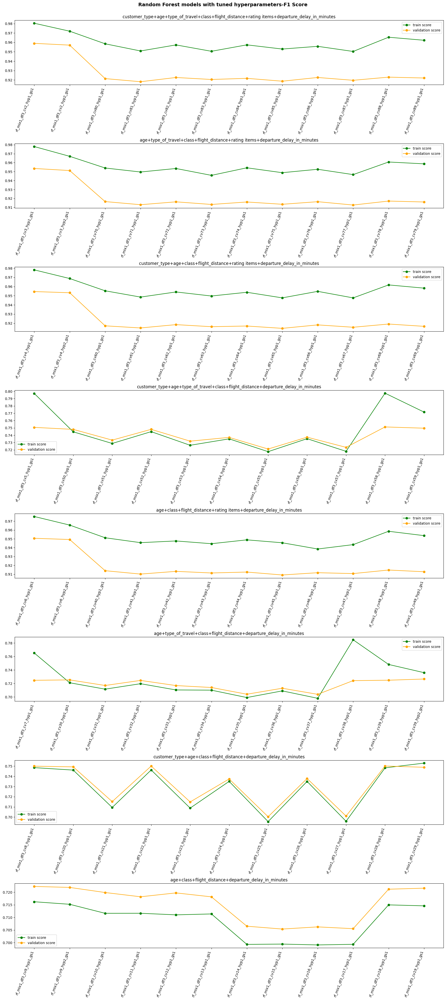

In [75]:
##############################################
#Show Trian and Validation Results
#F1 score
##############################################

fig, axs = plt.subplots(8, 1, figsize=(18,40))

metrics=['precision','recall', 'F1','accuracy','ROC_AUC']

for features,feature_index, ax in zip(feature_index_map.keys(),feature_index_map.values(), axs.ravel()):
    rf_train_score['feature_index']=rf_train_score['model'].str.extract(r'_cv(\d+)_').astype(int)
    rf_val_score['feature_index']=rf_val_score['model'].str.extract(r'_cv(\d+)_').astype(int)
    mask_train=rf_train_score['feature_index'].isin(feature_index)
    mask_val=rf_val_score['feature_index'].isin(feature_index)
    #plot train scores
    ax.plot(rf_train_score[mask_train]['model'], rf_train_score[mask_train]['F1'], color='green', label='train score',marker='o')
    #plot validation scores
    ax.plot(rf_val_score[mask_val]['model'], rf_val_score[mask_val]['F1'], color='orange', label='validation score',marker='o')
    ax.set_title(features)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=70, ha='right')
    ax.legend()

plt.suptitle('Random Forest models with tuned hyperparameters-F1 Score',y=1,fontsize=14,fontweight='bold')
plt.tight_layout()
plt.show()

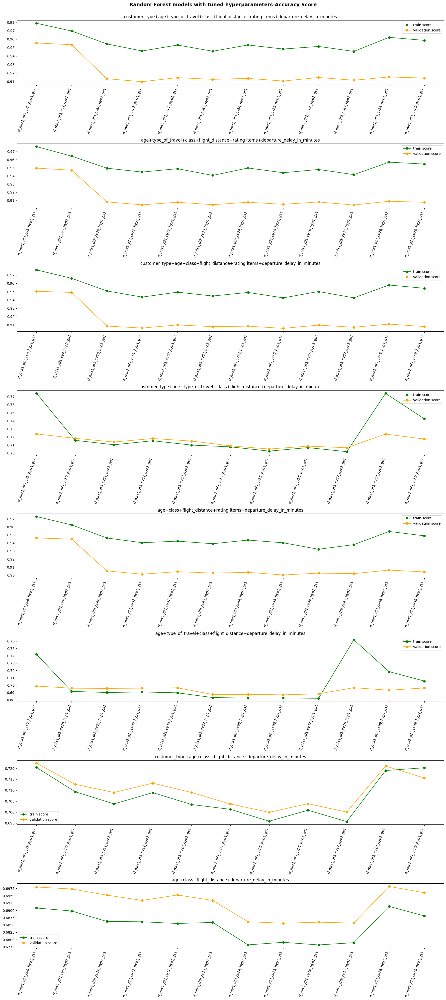

In [76]:
##############################################
#Show Trian and Validation Results
#accuracy score
##############################################

fig, axs = plt.subplots(8, 1, figsize=(18,40))

metrics=['precision','recall', 'F1','accuracy','ROC_AUC']


for features,feature_index, ax in zip(feature_index_map.keys(),feature_index_map.values(), axs.ravel()):
    rf_train_score['feature_index']=rf_train_score['model'].str.extract(r'_cv(\d+)_').astype(int)
    rf_val_score['feature_index']=rf_val_score['model'].str.extract(r'_cv(\d+)_').astype(int)
    mask_train=rf_train_score['feature_index'].isin(feature_index)
    mask_val=rf_val_score['feature_index'].isin(feature_index)
    #plot train scores
    ax.plot(rf_train_score[mask_train]['model'], rf_train_score[mask_train]['accuracy'], color='green', label='train score',marker='o')
    #plot validation scores
    ax.plot(rf_val_score[mask_val]['model'], rf_val_score[mask_val]['accuracy'], color='orange', label='validation score',marker='o')
    ax.set_title(features)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=70, ha='right')
    ax.legend()

plt.suptitle('Random Forest models with tuned hyperparameters-Accuracy Score',y=1,fontsize=14,fontweight='bold')
plt.tight_layout()
plt.show()